In [1]:

from PIL import Image


In [2]:
import pathlib
import subprocess
from dataclasses import dataclass
from typing import Literal, Tuple

import numpy as np
import nibabel as nib
import PIL
from PIL import ImageEnhance

import torch
from torch.utils.data import Dataset
import torchvision.transforms.v2 as transforms

import random
from utils.const import DATA_FOLDER
from utils.elastic_deformation import get_displacement

import matplotlib.pyplot as plt

In [3]:
def process_img(path, size):
    img = (nib.load(path).get_fdata() * 255).astype(np.uint8).squeeze()
    img = PIL.Image.fromarray(img)
    img = img.resize(size, resample=PIL.Image.BILINEAR)
    img = img.convert("L")
    img = np.array(img)
    img = img.astype(np.float32) / 255
    img = np.rot90(img, -1)
    return img.copy()

def process_seg(path: pathlib.Path, size: Tuple[int, int]):
    seg = nib.load(path).get_fdata().astype(np.int8).squeeze()
    seg = PIL.Image.fromarray(seg)
    seg = seg.resize(size, resample=PIL.Image.NEAREST)
    seg = np.array(seg)
    seg = seg.astype(np.float32)
    seg = np.rot90(seg, -1)
    return seg.copy()

In [4]:
def load_sample():
    img = process_img("/projectnb/ec500kb/projects/UniverSeg/data/OASIS_OAS1_0001_MR1/slice_norm.nii.gz", (128,128))
    seg = process_seg("/projectnb/ec500kb/projects/UniverSeg/data/OASIS_OAS1_0001_MR1/slice_seg24.nii.gz", (128,128))
    
    img = torch.from_numpy(img)
    seg = torch.from_numpy(seg)
    
    img = torch.unsqueeze(img, 0)
    seg = torch.unsqueeze(seg, 0)

    return img, seg

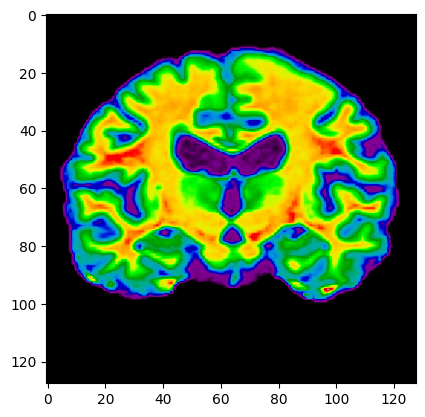

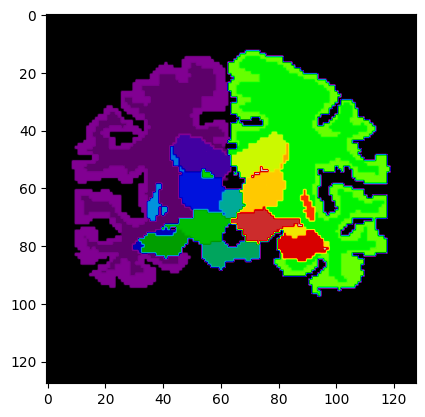

In [6]:
def show_image(image, cmap = "nipy_spectral"):
    plt.imshow(image.cpu().squeeze().numpy(), cmap = cmap)
    plt.show()

def show_seg_label(seg_label):
    plt.imshow(seg_label.cpu().squeeze().numpy(), cmap = "nipy_spectral")
    plt.show()

img, seg = load_sample()
show_image(img)
show_seg_label(seg)

# Affine Shift

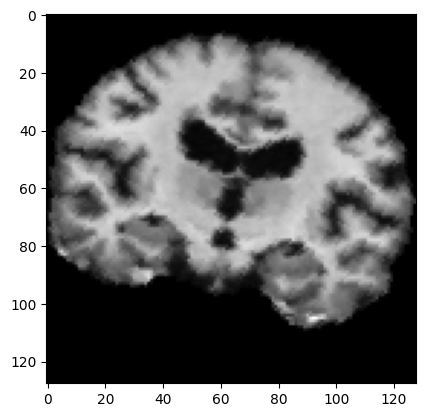

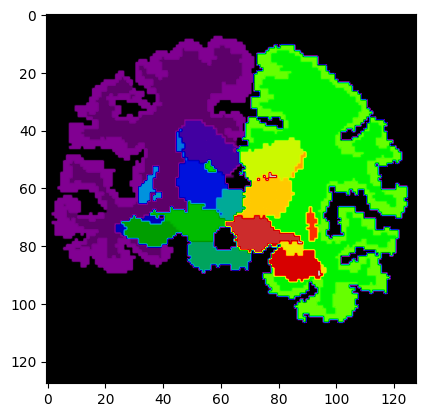

In [35]:
img, seg = load_sample()

degree = random.randint(-15, 15)
translate_x = random.uniform(0, 0.2)
translate_y = random.uniform(0, 0.2)
scale = random.uniform(0.8, 1.1)
shear = 0
img = transforms.functional.affine(img, degree, [translate_x, translate_y], scale, shear)
seg = transforms.functional.affine(seg, degree, [translate_x, translate_y], scale, shear)

show_image(img)
show_seg_label(seg)


# Horizontal Flip

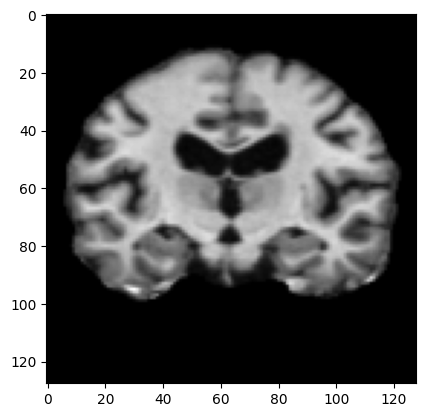

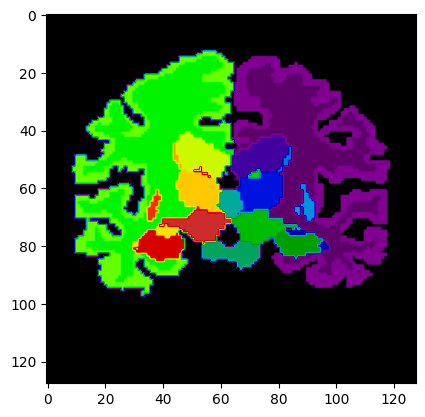

In [140]:
img, seg = load_sample()


img = transforms.functional.hflip(img)
seg = transforms.functional.hflip(seg)

show_image(img)
show_seg_label(seg)

# Elastic Warp

tensor(8050)
tensor(16384)
Mean Absolute Difference: 1.1008964975189883e-06


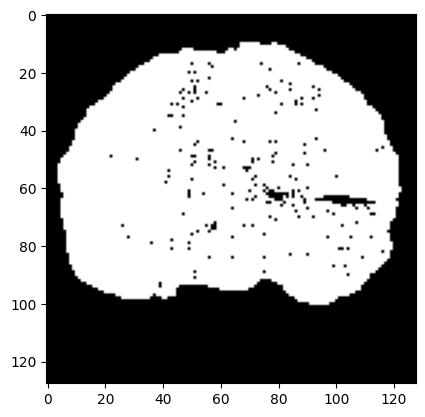

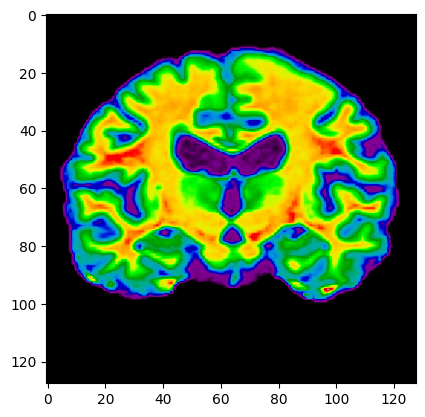

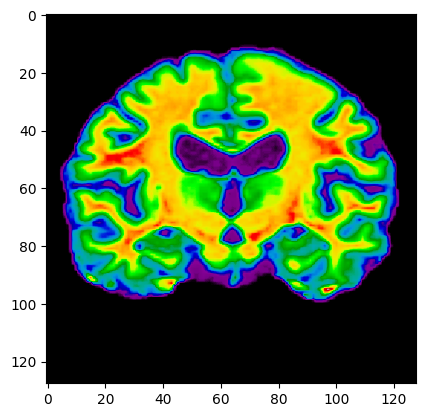

In [318]:
img, seg = load_sample()

alpha = random.uniform(1, 2.5)
sigma = random.uniform(7, 8)
_, height, width = transforms.functional.get_dimensions(img)
displacement = get_displacement(0.02, 30, [height, width])
img2 = transforms.functional.elastic(img, displacement, transforms.InterpolationMode.BILINEAR)
seg2 = transforms.functional.elastic(seg, displacement, transforms.InterpolationMode.NEAREST)

print(torch.sum(img2==img))
print(torch.sum(seg2==seg))
# show_image(img)
# show_image(img2)

# Assuming img and img2 are your images
mad = torch.mean(torch.abs(img2 - img))
print("Mean Absolute Difference:", mad.item())

show_image(img!=img2, "gray")
show_image(img)
show_seg_label(img2)

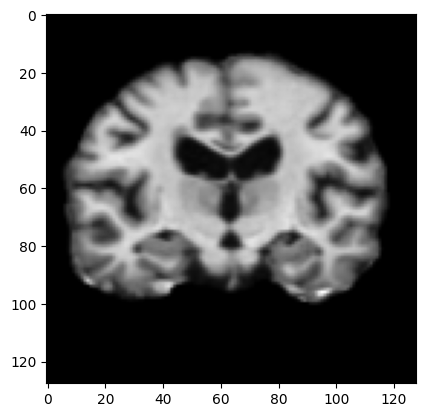

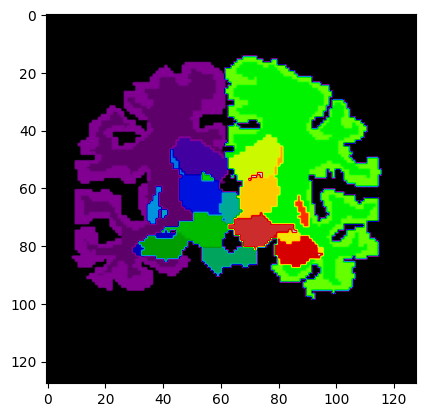

In [138]:
img, seg = load_sample()

alpha = random.uniform(1, 2.5)
sigma = random.uniform(7, 8)
_, height, width = transforms.functional.get_dimensions(img)
displacement = get_displacement(250, 20, [height, width])
img2 = transforms.functional.elastic(img, displacement, transforms.InterpolationMode.BILINEAR)
seg2 = transforms.functional.elastic(seg, displacement, transforms.InterpolationMode.NEAREST)

show_image(img2)
show_seg_label(seg2)

# Brightness Contrast Change

In [192]:
img, seg = load_sample()


# Adjust brightness and contrast
jitter = transforms.ColorJitter(brightness=0.8, contrast=0.5)
img2 = jitter(img)

print(torch.sum(img2==img))
# show_image(img)
# show_image(img2)

# Assuming img and img2 are your images
mad = torch.mean(torch.abs(img2 - img))
print("Mean Absolute Difference:", mad.item())


tensor(0)
Mean Absolute Difference: 0.027043649926781654


In [172]:
img.unique()

tensor([0.0000, 0.0039, 0.0078, 0.0118, 0.0157, 0.0196, 0.0235, 0.0275, 0.0314,
        0.0353, 0.0392, 0.0431, 0.0471, 0.0510, 0.0549, 0.0588, 0.0627, 0.0667,
        0.0706, 0.0745, 0.0784, 0.0824, 0.0863, 0.0902, 0.0941, 0.0980, 0.1020,
        0.1059, 0.1098, 0.1137, 0.1176, 0.1216, 0.1255, 0.1294, 0.1333, 0.1373,
        0.1412, 0.1451, 0.1490, 0.1529, 0.1569, 0.1608, 0.1647, 0.1686, 0.1725,
        0.1765, 0.1804, 0.1843, 0.1882, 0.1922, 0.1961, 0.2000, 0.2039, 0.2078,
        0.2118, 0.2157, 0.2196, 0.2235, 0.2275, 0.2314, 0.2353, 0.2392, 0.2431,
        0.2471, 0.2510, 0.2549, 0.2588, 0.2627, 0.2667, 0.2706, 0.2745, 0.2784,
        0.2824, 0.2863, 0.2902, 0.2941, 0.2980, 0.3020, 0.3059, 0.3098, 0.3137,
        0.3176, 0.3216, 0.3255, 0.3294, 0.3333, 0.3373, 0.3412, 0.3451, 0.3490,
        0.3529, 0.3569, 0.3608, 0.3647, 0.3686, 0.3725, 0.3765, 0.3804, 0.3843,
        0.3882, 0.3922, 0.3961, 0.4000, 0.4039, 0.4078, 0.4118, 0.4157, 0.4196,
        0.4235, 0.4275, 0.4314, 0.4353, 

In [173]:
img2.unique()

tensor([0.0000, 0.0038, 0.0100, 0.0162, 0.0224, 0.0286, 0.0348, 0.0410, 0.0472,
        0.0534, 0.0596, 0.0658, 0.0720, 0.0782, 0.0844, 0.0906, 0.0968, 0.1030,
        0.1092, 0.1154, 0.1216, 0.1278, 0.1340, 0.1402, 0.1464, 0.1526, 0.1588,
        0.1650, 0.1712, 0.1774, 0.1836, 0.1898, 0.1959, 0.2021, 0.2083, 0.2145,
        0.2207, 0.2269, 0.2331, 0.2393, 0.2455, 0.2517, 0.2579, 0.2641, 0.2703,
        0.2765, 0.2827, 0.2889, 0.2951, 0.3013, 0.3075, 0.3137, 0.3199, 0.3261,
        0.3323, 0.3385, 0.3447, 0.3509, 0.3571, 0.3633, 0.3695, 0.3757, 0.3819,
        0.3881, 0.3943, 0.4004, 0.4066, 0.4128, 0.4190, 0.4252, 0.4314, 0.4376,
        0.4438, 0.4500, 0.4562, 0.4624, 0.4686, 0.4748, 0.4810, 0.4872, 0.4934,
        0.4996, 0.5058, 0.5120, 0.5182, 0.5244, 0.5306, 0.5368, 0.5430, 0.5492,
        0.5554, 0.5616, 0.5678, 0.5740, 0.5802, 0.5864, 0.5926, 0.5987, 0.6049,
        0.6111, 0.6173, 0.6235, 0.6297, 0.6359, 0.6421, 0.6483, 0.6545, 0.6607,
        0.6669, 0.6731, 0.6793, 0.6917, 

# Sharpness Change

4.18677006563777
tensor(8261)


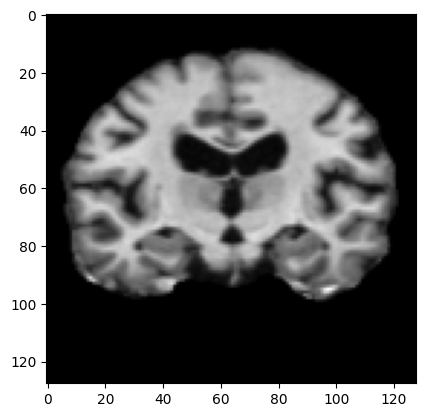

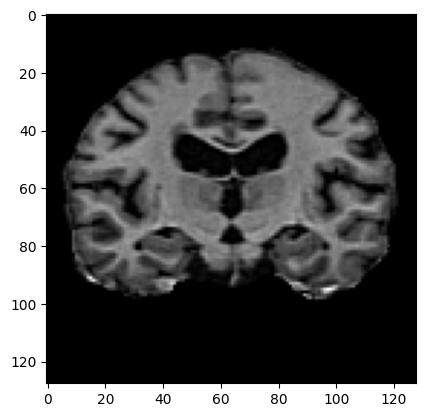

Mean Absolute Difference: 0.012812567874789238
1.8386040260725434
tensor(8261)


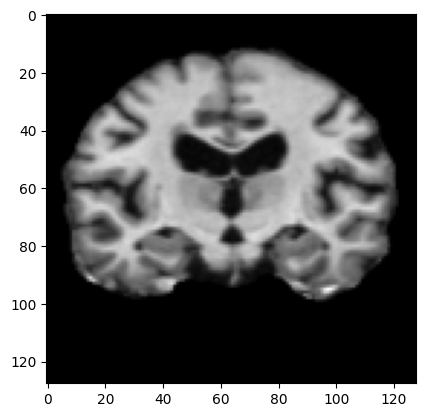

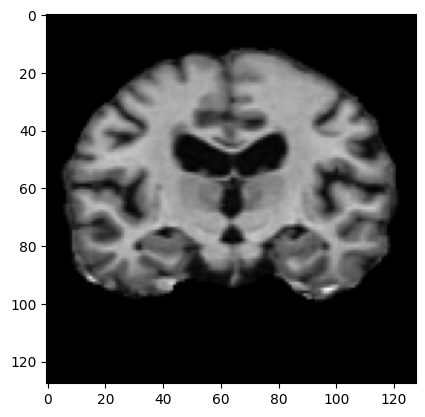

Mean Absolute Difference: 0.0035263909958302975
0.08701476115478335
tensor(7815)


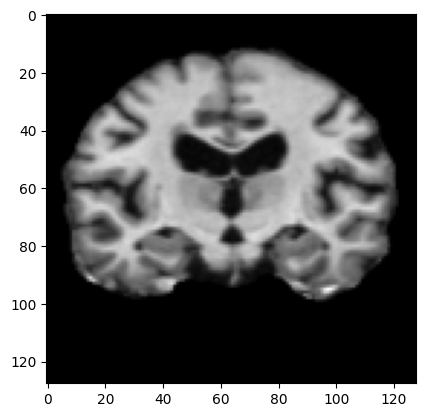

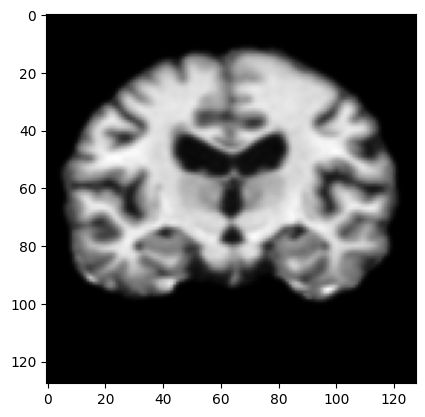

Mean Absolute Difference: 0.004069766029715538
4.599992351280939
tensor(8261)


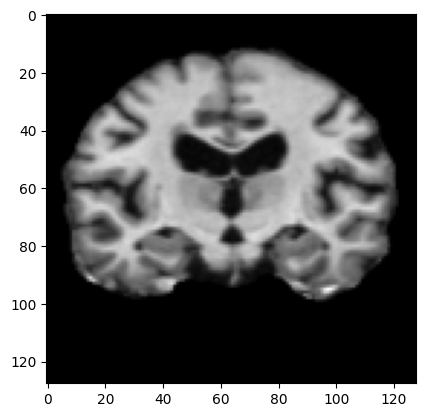

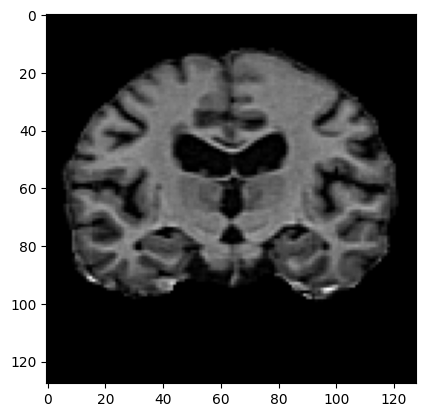

Mean Absolute Difference: 0.014339028857648373
4.220161529238881
tensor(8261)


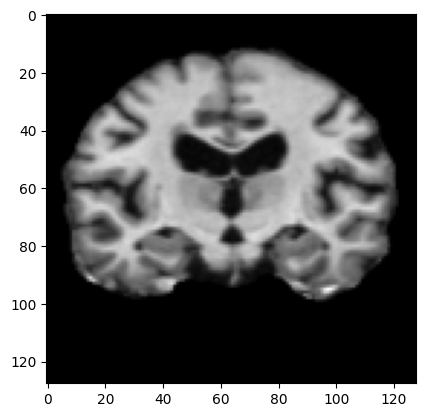

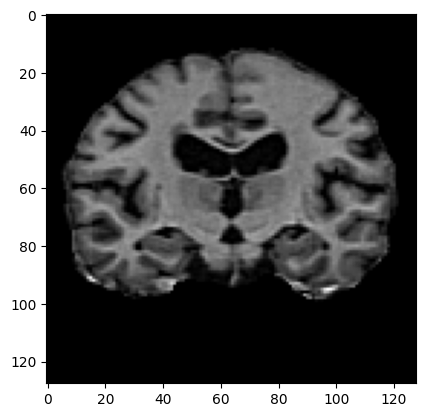

Mean Absolute Difference: 0.012936930172145367
3.770364090099184
tensor(8261)


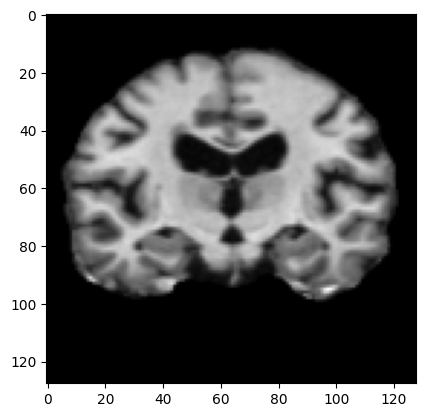

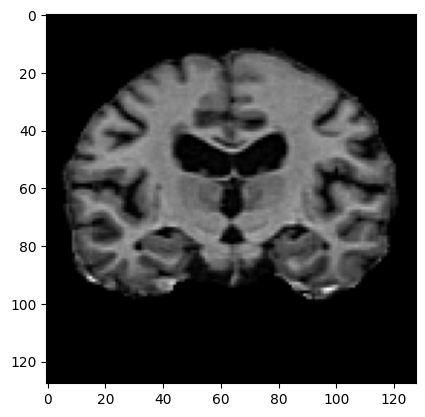

Mean Absolute Difference: 0.011242635548114777
1.0048602014414647
tensor(8261)


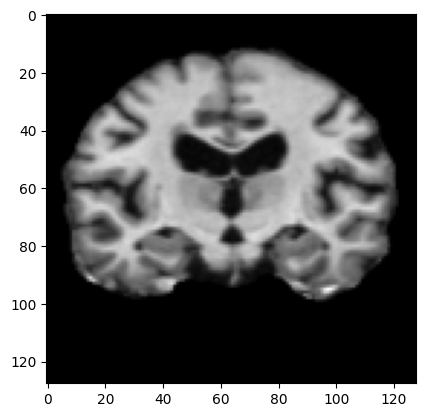

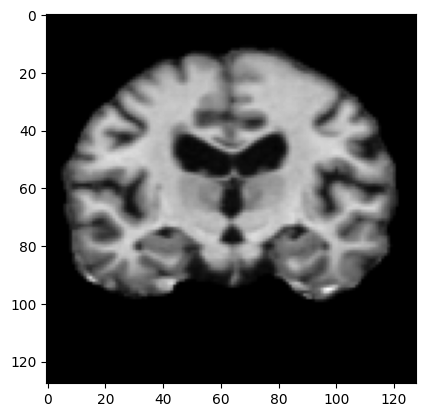

Mean Absolute Difference: 2.071584458462894e-05
2.4784645822591904
tensor(8261)


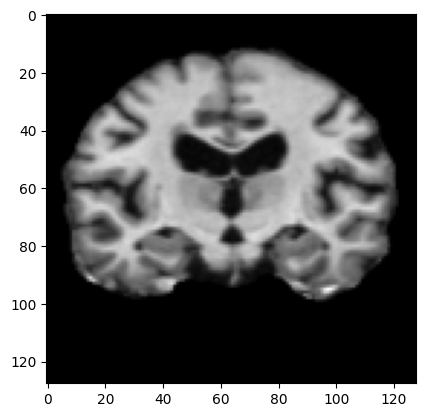

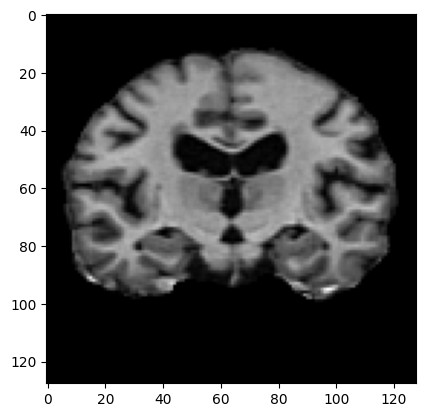

Mean Absolute Difference: 0.006155845709145069
267 ms ± 520 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [224]:
%%timeit

img, seg = load_sample()

sharpness_factor = random.uniform(0, 5)
# Adjust sharpness
img2 = transforms.functional.adjust_sharpness(img, sharpness_factor)

print(sharpness_factor)
print(torch.sum(img2==img))
show_image(img, "gray")
show_image(img2, "gray")

# Assuming img and img2 are your images
mad = torch.mean(torch.abs(img2 - img))
print("Mean Absolute Difference:", mad.item())


1.69
tensor(8261)


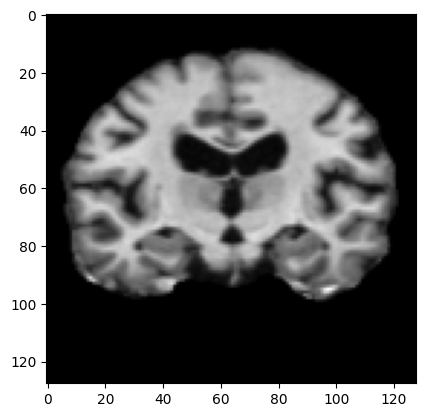

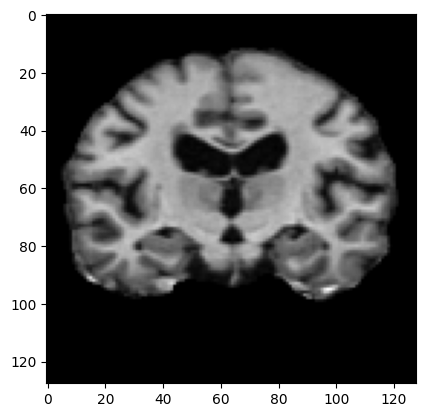

Mean Absolute Difference: 0.002908893395215273
3.41
tensor(8261)


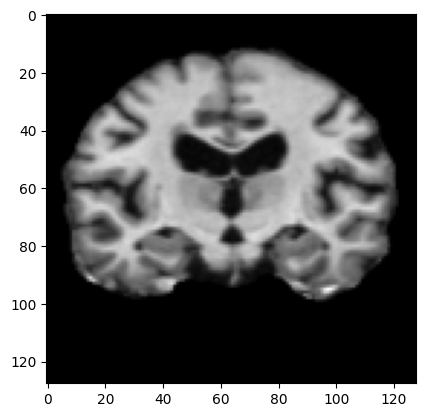

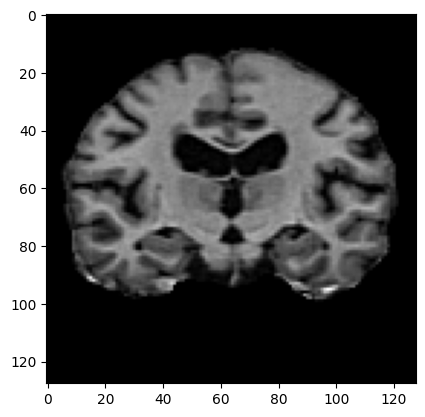

Mean Absolute Difference: 0.009857508353888988
3.81
tensor(8261)


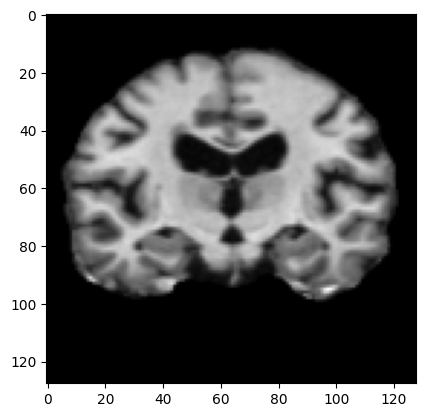

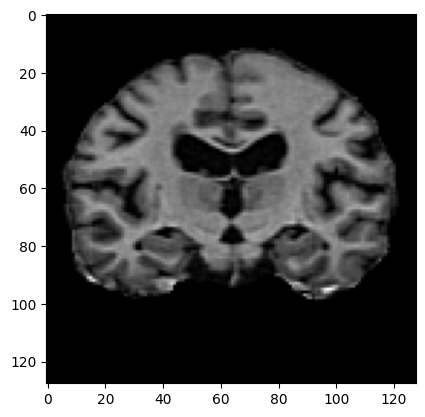

Mean Absolute Difference: 0.011393534019589424
1.45
tensor(8261)


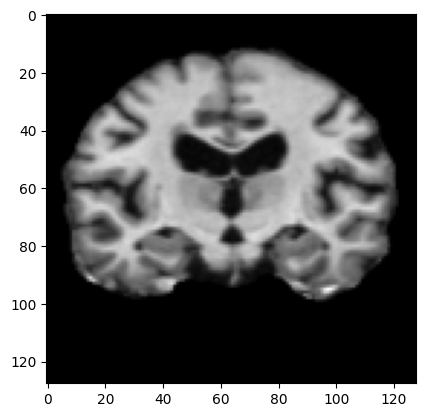

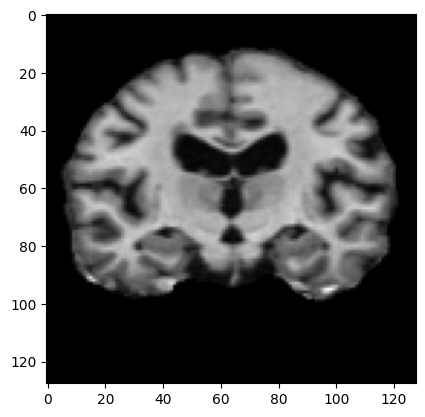

Mean Absolute Difference: 0.0019062713254243135
2.31
tensor(8261)


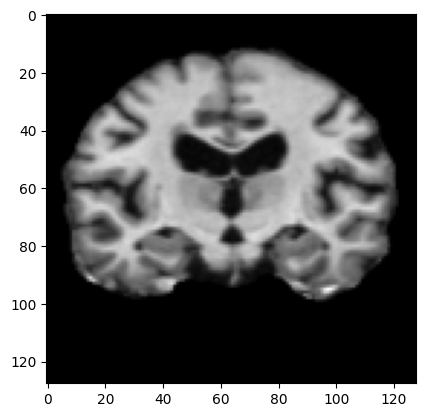

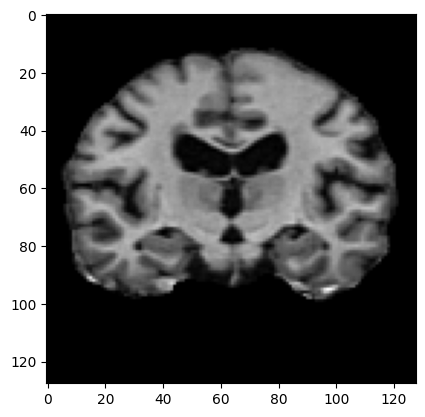

Mean Absolute Difference: 0.005468809045851231
0.47
tensor(7815)


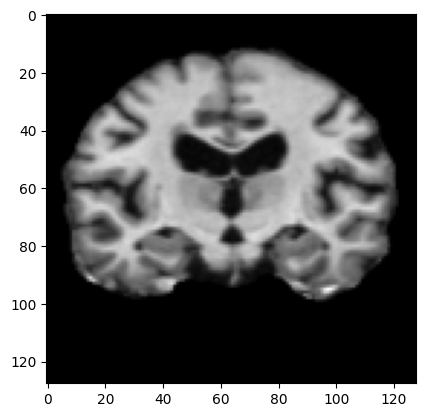

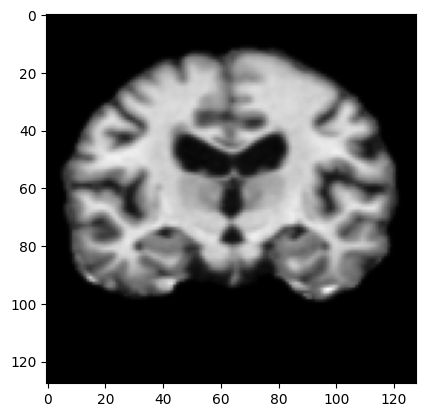

Mean Absolute Difference: 0.0023625530302524567
1.45
tensor(8261)


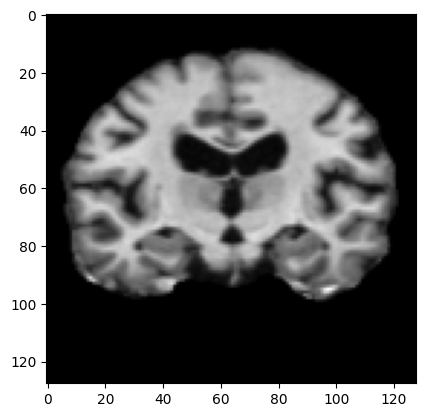

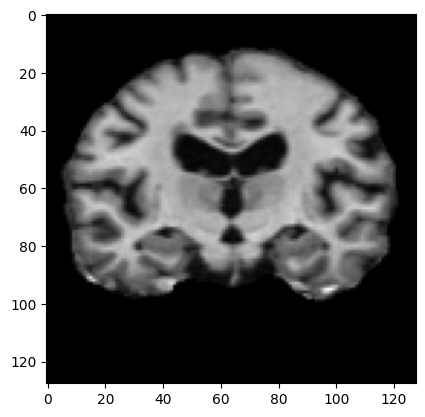

Mean Absolute Difference: 0.0019062713254243135
0.02
tensor(7815)


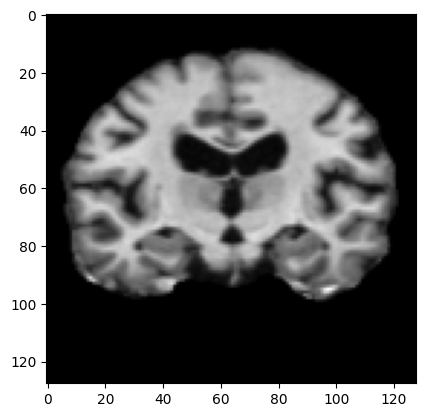

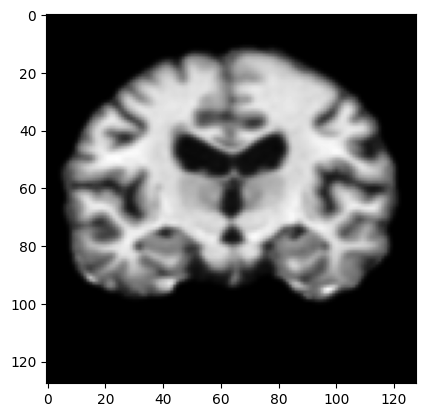

Mean Absolute Difference: 0.004368494264781475
268 ms ± 1.33 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [223]:
%%timeit

img, seg = load_sample()

sharpness_factor = round(random.uniform(0, 5),2)
# Adjust sharpness
img2 = transforms.functional.adjust_sharpness(img, sharpness_factor)

print(sharpness_factor)
print(torch.sum(img2==img))
show_image(img, "gray")
show_image(img2, "gray")

# Assuming img and img2 are your images
mad = torch.mean(torch.abs(img2 - img))
print("Mean Absolute Difference:", mad.item())


# Gaussian Blur

0.6206946965089667
tensor(7236)


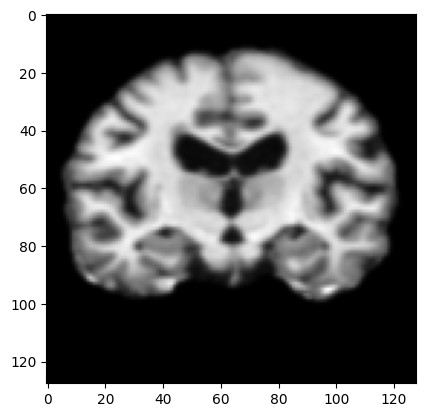

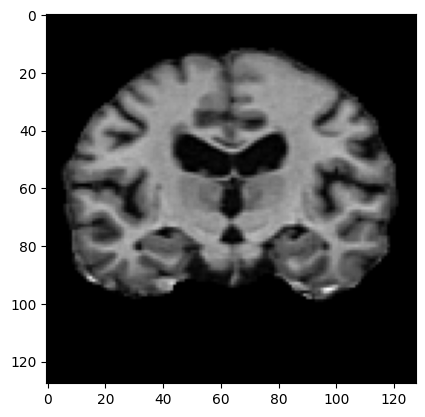

Mean Absolute Difference: 0.010049210861325264
1.0499751046852237
tensor(7236)


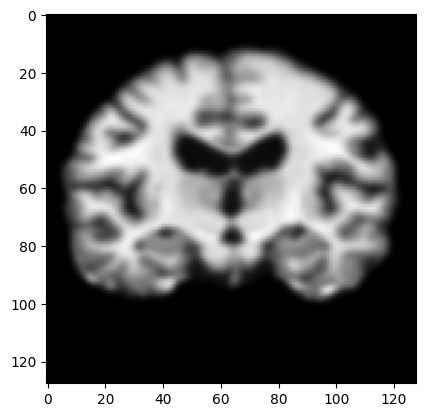

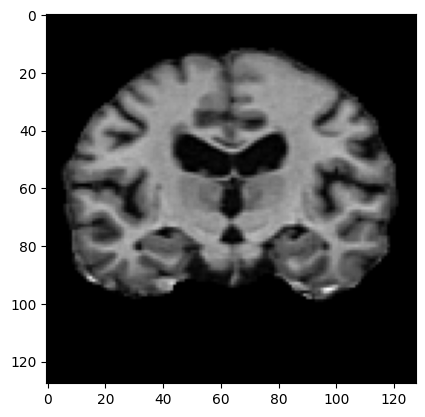

Mean Absolute Difference: 0.01421238761395216
0.4541305525587842
tensor(7237)


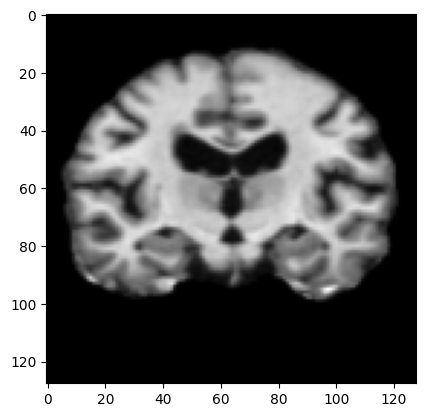

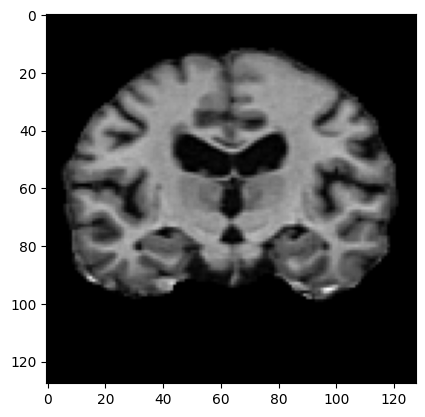

Mean Absolute Difference: 0.007886352017521858
1.0810069997094585
tensor(7236)


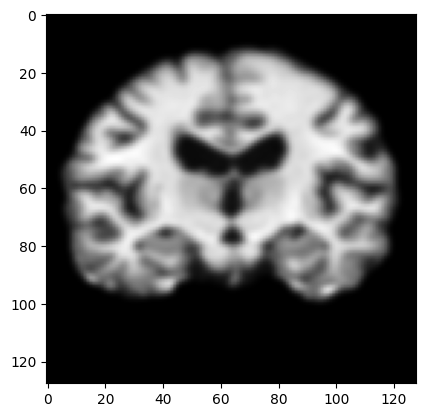

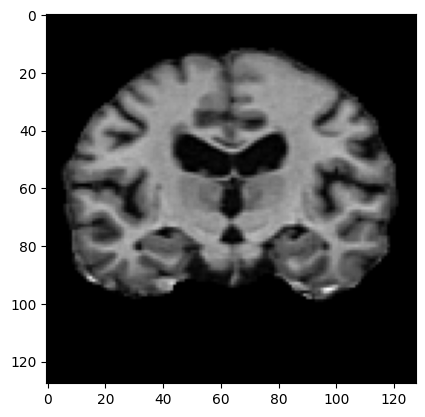

Mean Absolute Difference: 0.014447147026658058
0.4265866645637587
tensor(7237)


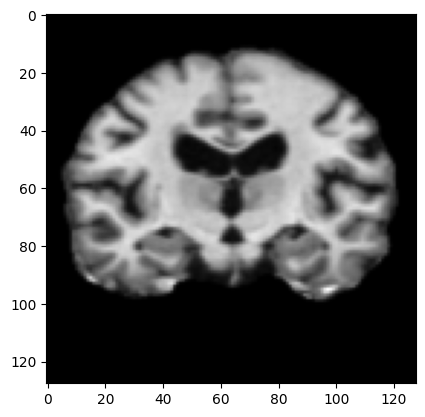

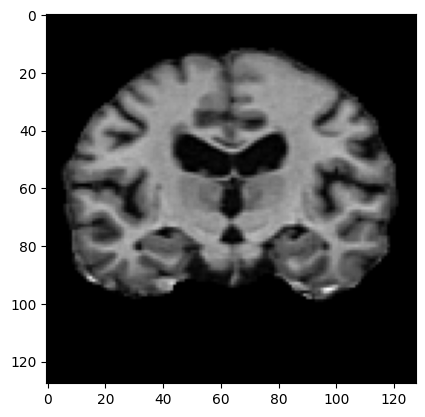

Mean Absolute Difference: 0.007507540285587311
0.20766422614877503
tensor(7242)


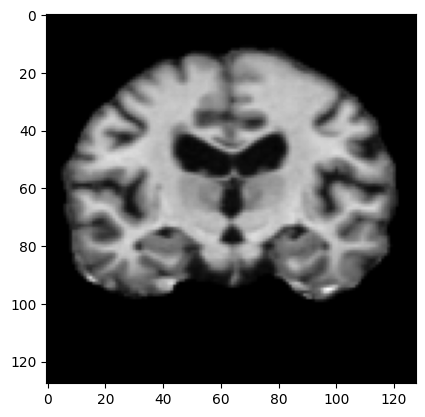

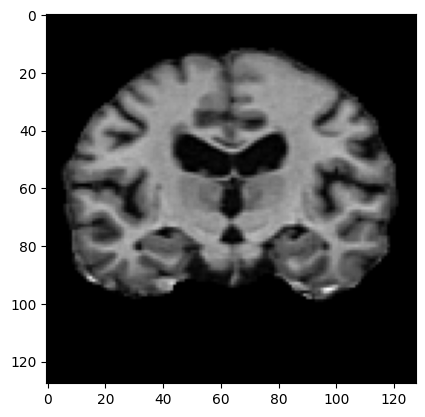

Mean Absolute Difference: 0.0063200443983078
0.260497773105815
tensor(7236)


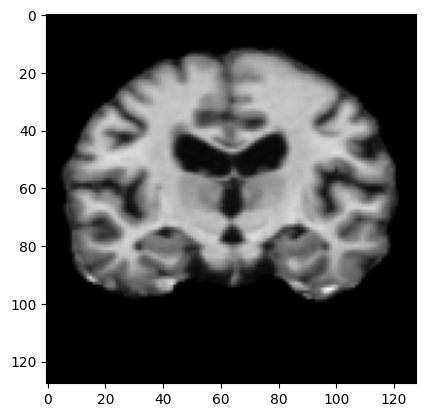

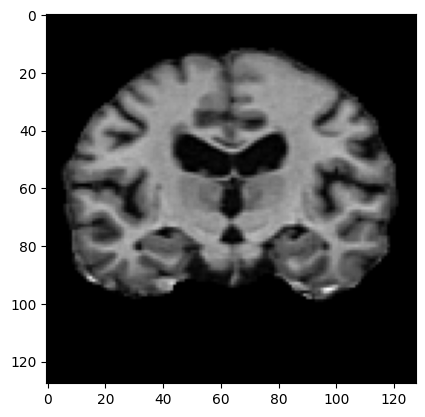

Mean Absolute Difference: 0.006333217024803162
0.43325374611197476
tensor(7238)


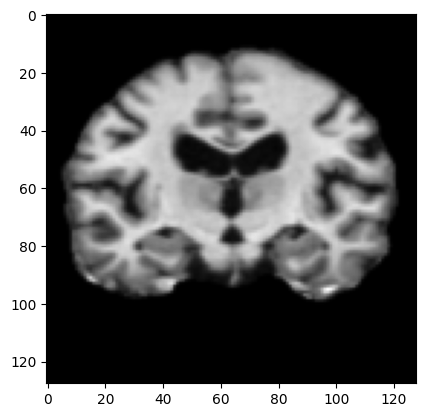

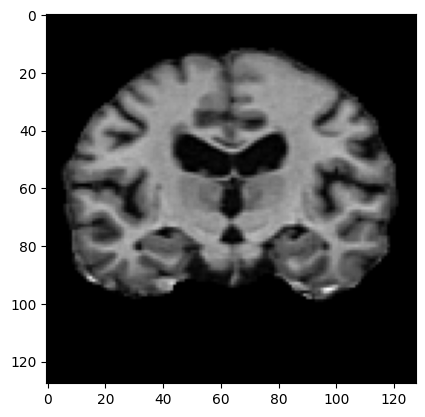

Mean Absolute Difference: 0.007597528863698244
267 ms ± 809 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [225]:
%%timeit

img, seg = load_sample()

sigma_val = random.uniform(0.1, 1.1)
img = transforms.functional.gaussian_blur(img, kernel_size = 5, sigma = sigma_val)


print(sigma_val)
print(torch.sum(img2==img))
show_image(img, "gray")
show_image(img2, "gray")

# Assuming img and img2 are your images
mad = torch.mean(torch.abs(img2 - img))
print("Mean Absolute Difference:", mad.item())

# Gaussian Noise        

0.02797886324853617 0.1750000504546533
tensor(0)


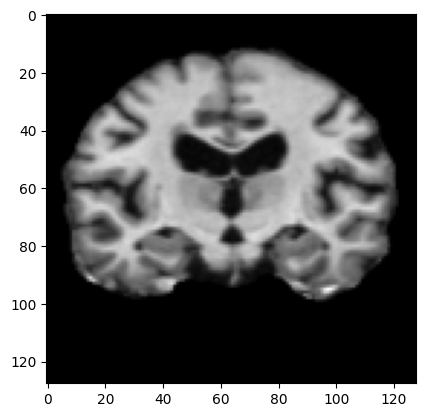

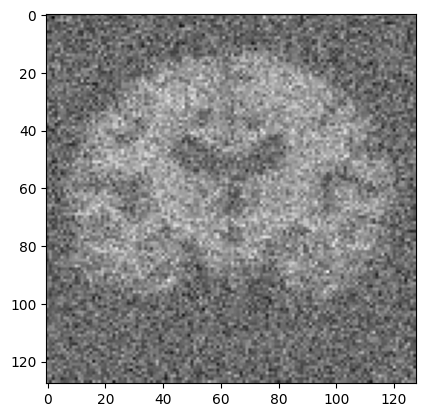

Mean Absolute Difference: 0.1423460692167282
0.04498105867166739 0.20677400735722248
tensor(0)


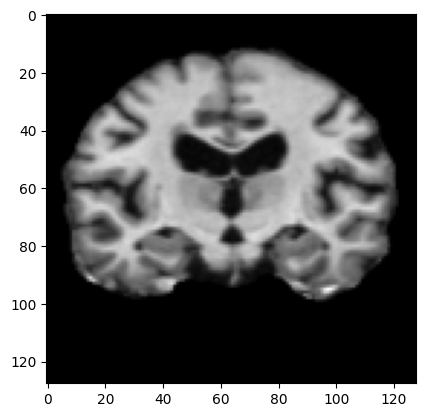

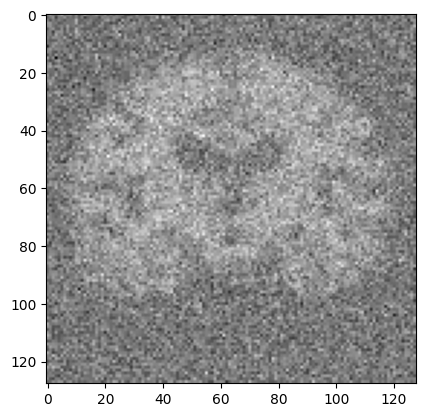

Mean Absolute Difference: 0.17193393409252167
0.018208846622951115 0.030450771013662115
tensor(0)


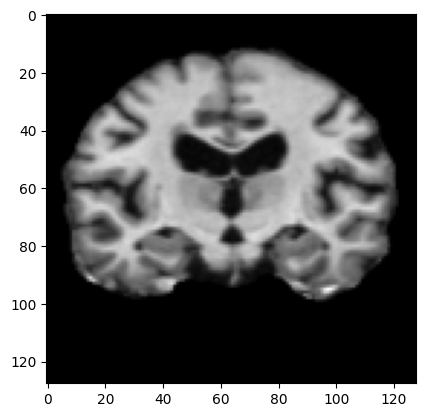

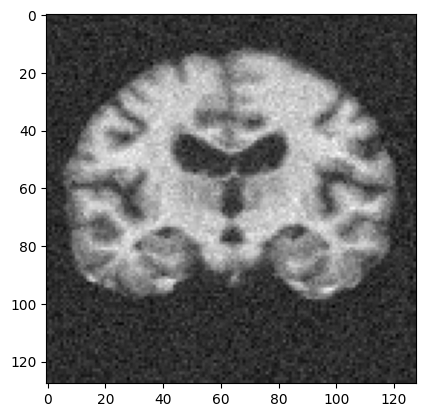

Mean Absolute Difference: 0.0284821055829525
0.035367247775933607 0.023230685461214845
tensor(0)


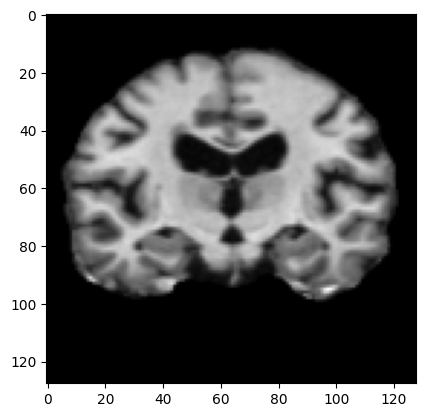

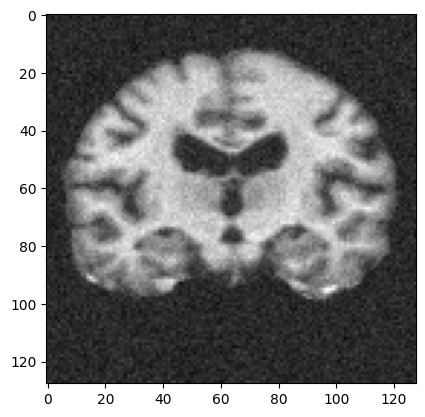

Mean Absolute Difference: 0.03660617768764496
0.013543325585015642 0.033933960095009465
tensor(0)


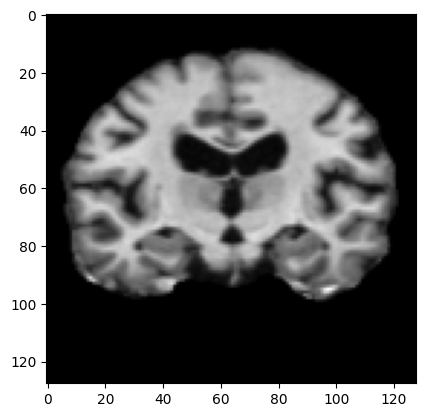

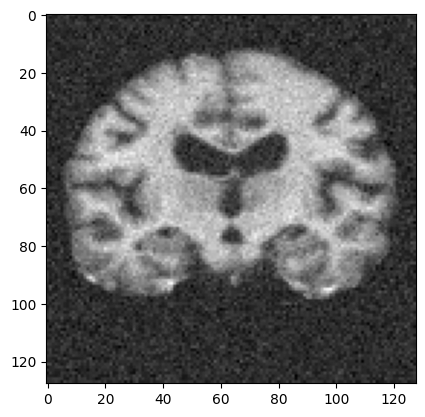

Mean Absolute Difference: 0.029204614460468292
0.010474355496666893 0.21050388601570294
tensor(0)


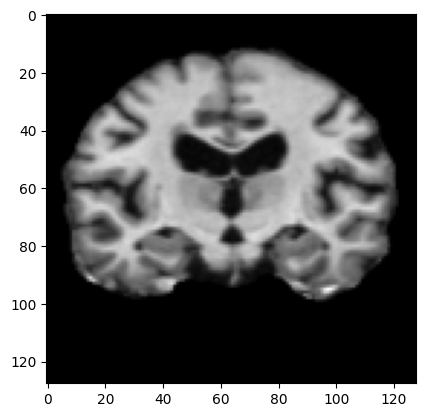

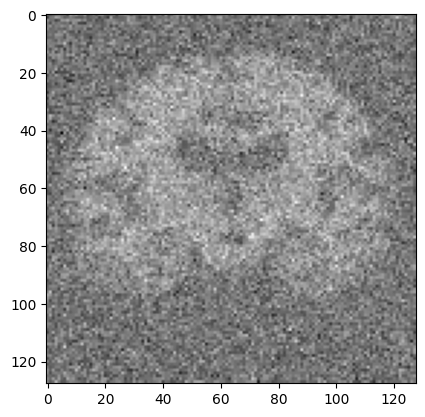

Mean Absolute Difference: 0.16640029847621918
0.005143946016004253 0.13481495390041798
tensor(0)


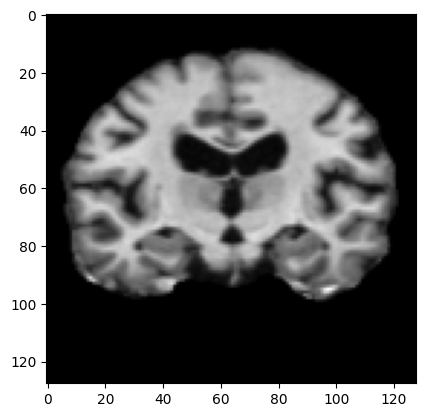

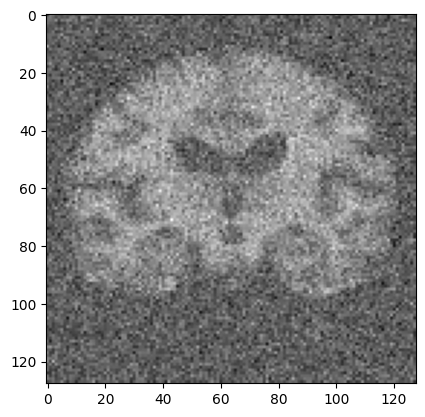

Mean Absolute Difference: 0.10758926719427109
0.04357660994051218 0.08161807596332661
tensor(0)


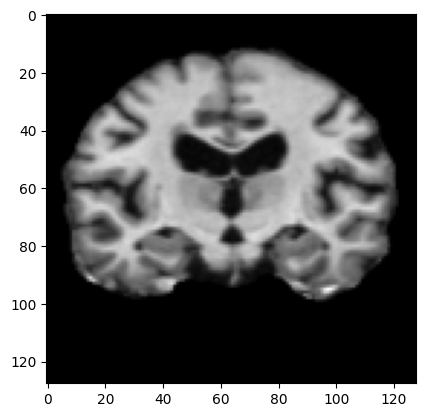

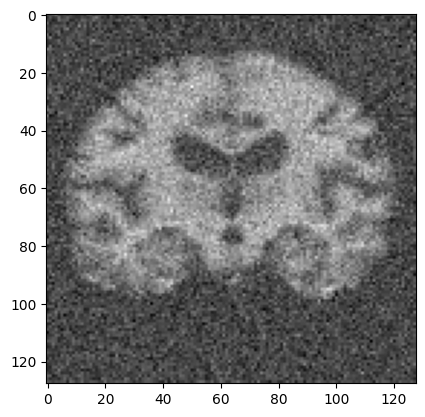

Mean Absolute Difference: 0.07484006881713867
0.02142729898654887 0.043179813717357955
tensor(0)


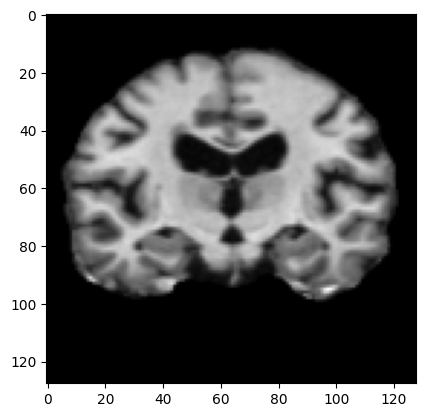

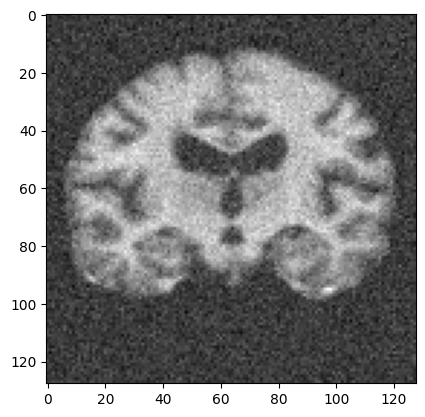

Mean Absolute Difference: 0.039036061614751816
0.037635555095465685 0.08772679952532793
tensor(0)


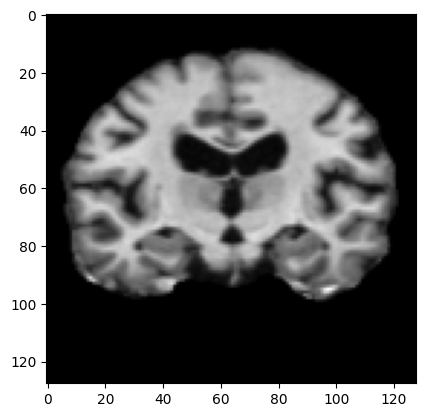

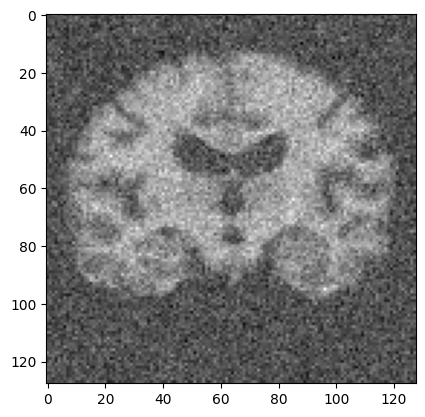

Mean Absolute Difference: 0.07669132947921753
0.006358090961985797 0.14956225658622993
tensor(0)


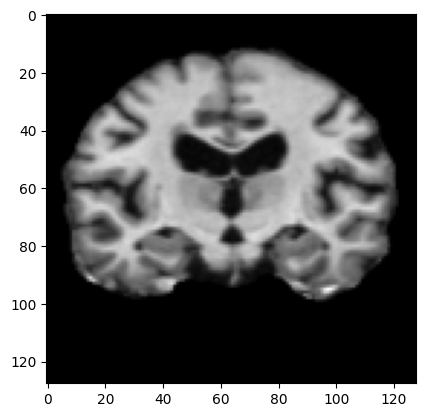

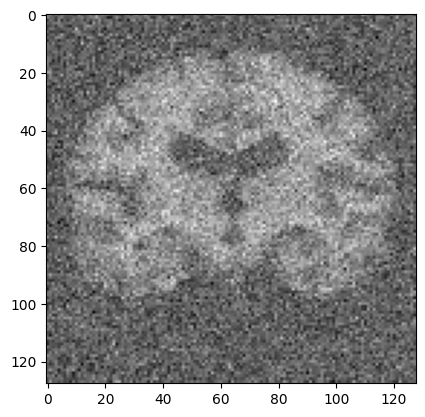

Mean Absolute Difference: 0.119865283370018
0.029016459464872076 0.05590176686702856
tensor(0)


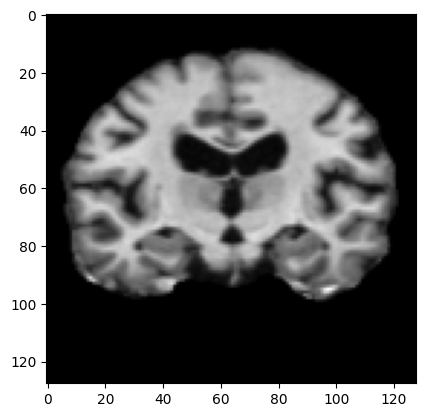

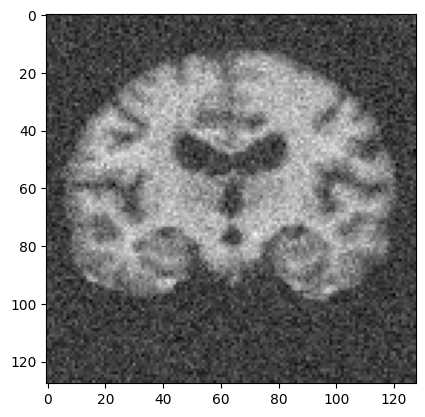

Mean Absolute Difference: 0.05056600645184517
0.016392502057667513 0.19589184402185184
tensor(0)


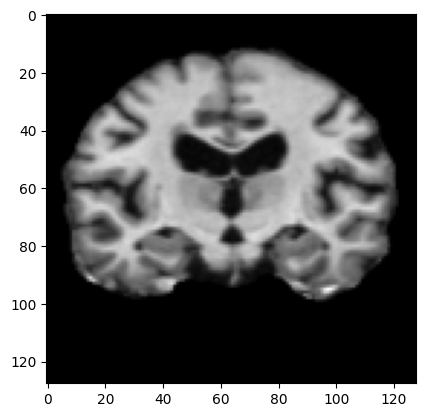

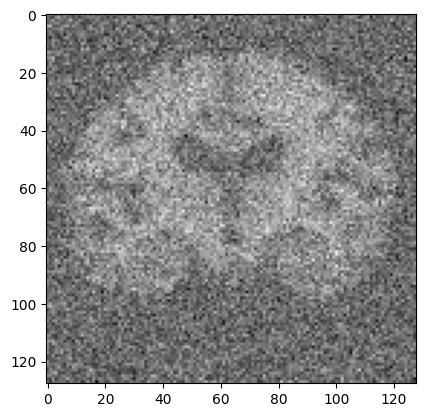

Mean Absolute Difference: 0.1573357880115509
0.03285609720052867 0.019458689260864626
tensor(0)


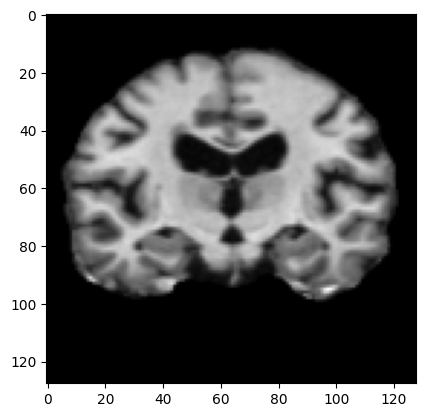

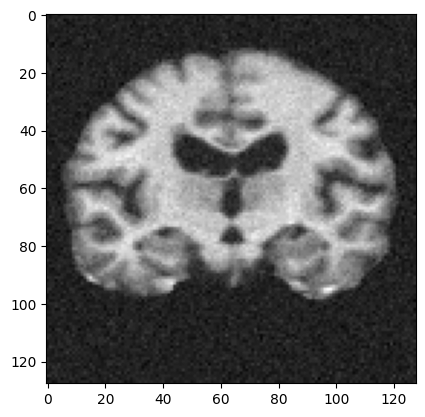

Mean Absolute Difference: 0.03366479650139809
0.031814654520358164 0.20739640082838343
tensor(0)


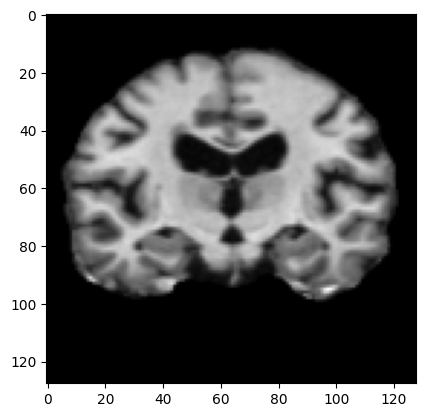

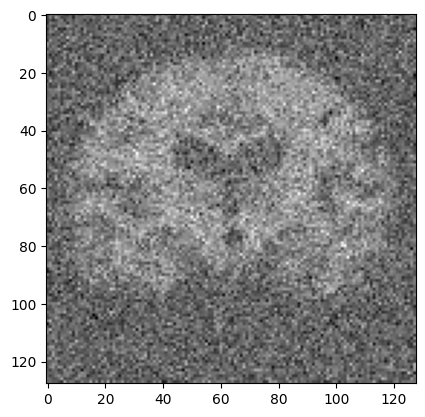

Mean Absolute Difference: 0.16795134544372559
0.03548819967061423 0.027409719991972666
tensor(0)


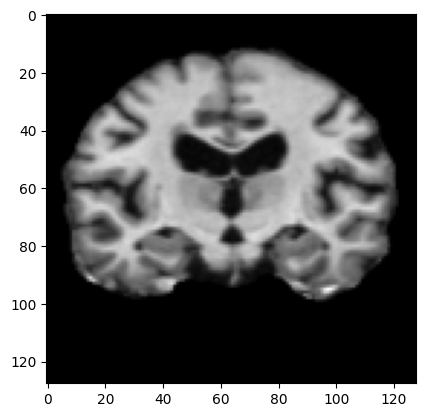

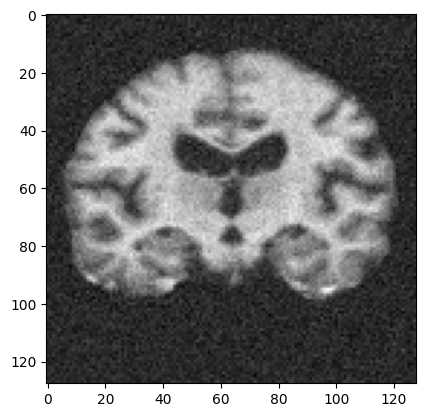

Mean Absolute Difference: 0.037955209612846375
0.04393013109953871 0.1503578162668444
tensor(0)


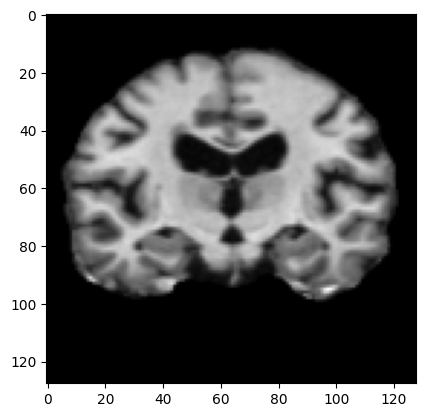

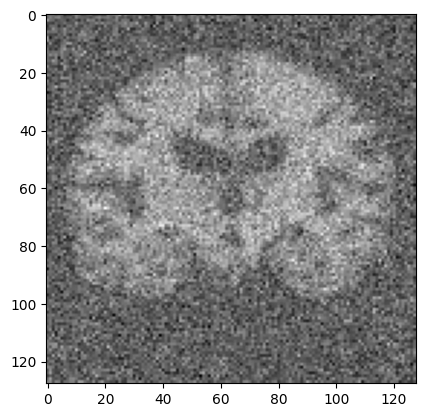

Mean Absolute Difference: 0.12312966585159302
0.017624884055339945 0.03253770505092204
tensor(0)


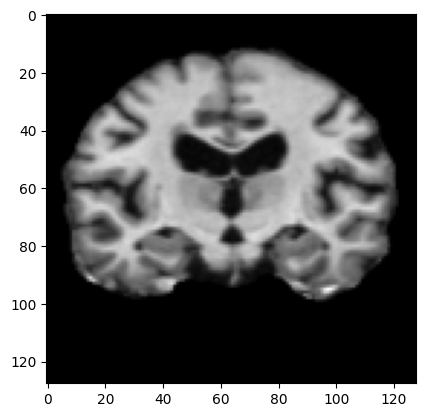

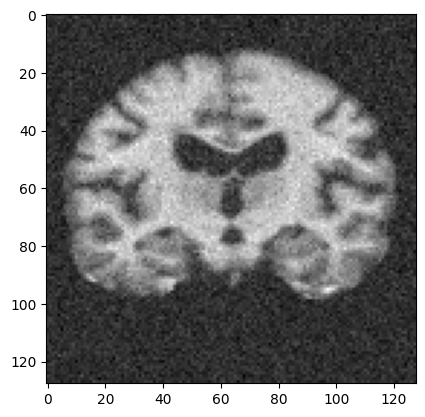

Mean Absolute Difference: 0.02987063303589821
0.04713865116752695 0.1860561323956309
tensor(0)


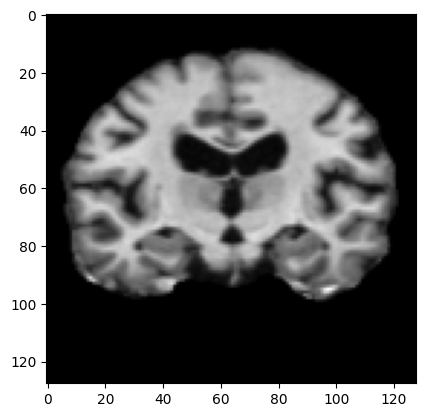

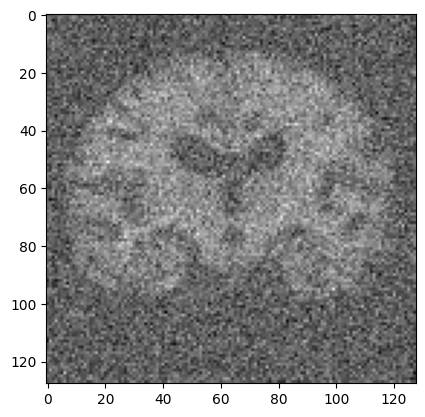

Mean Absolute Difference: 0.15423738956451416
0.04878177174060322 0.07780549752906145
tensor(0)


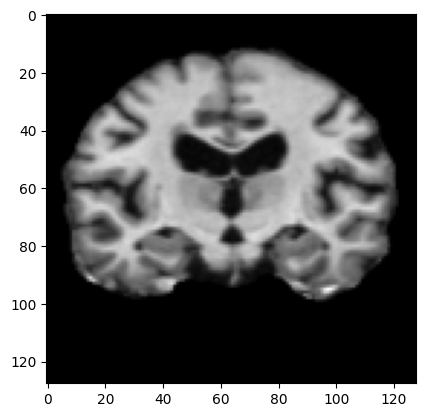

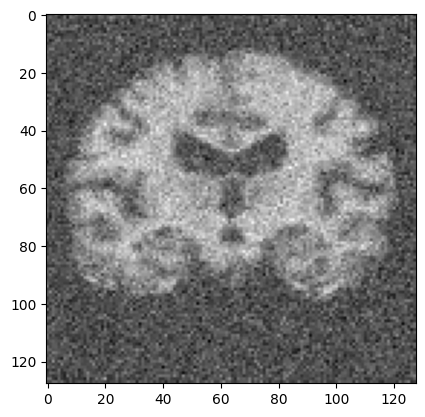

Mean Absolute Difference: 0.07384169101715088
0.005640863171515332 0.08167895174296991
tensor(0)


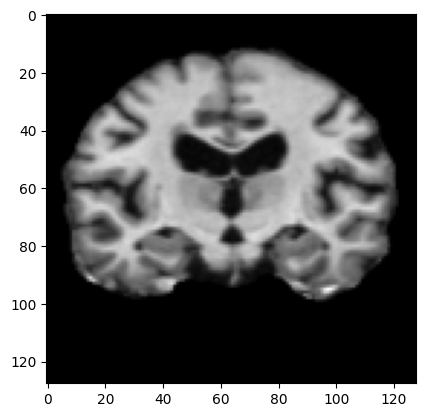

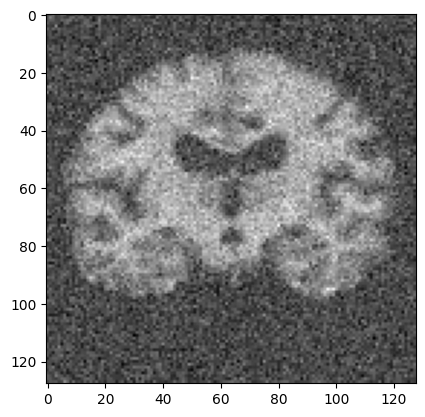

Mean Absolute Difference: 0.06562736630439758
0.036892652758501274 0.05611561569765411
tensor(0)


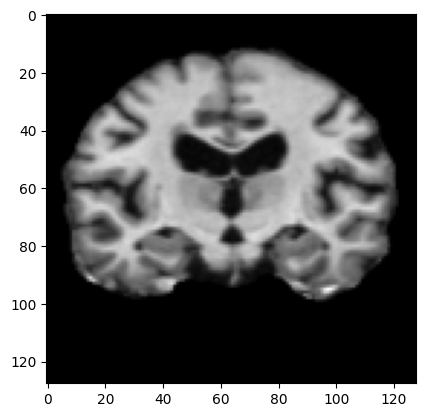

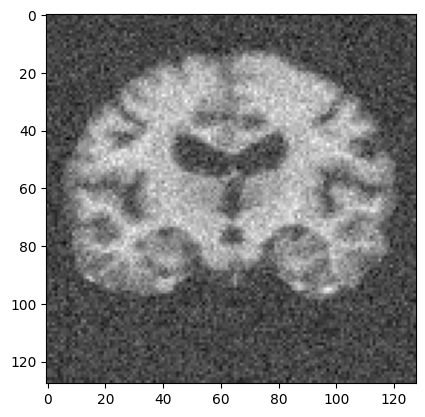

Mean Absolute Difference: 0.05391795188188553
0.010985998074873144 0.16059532178034
tensor(0)


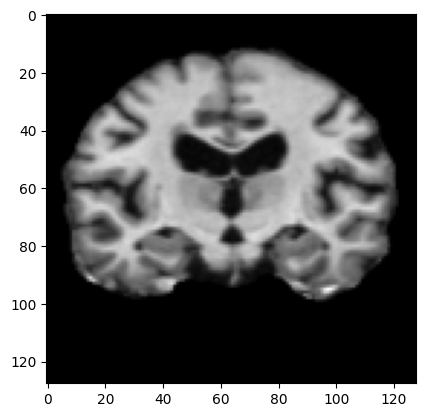

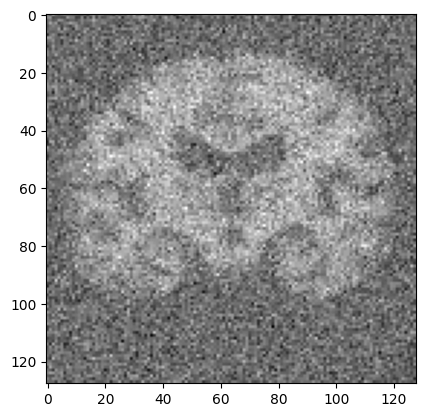

Mean Absolute Difference: 0.12788031995296478
0.012466361425745871 0.03399613797641628
tensor(0)


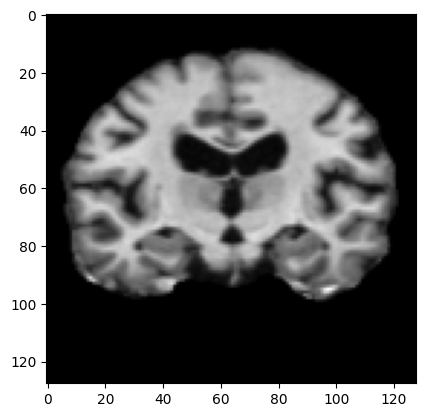

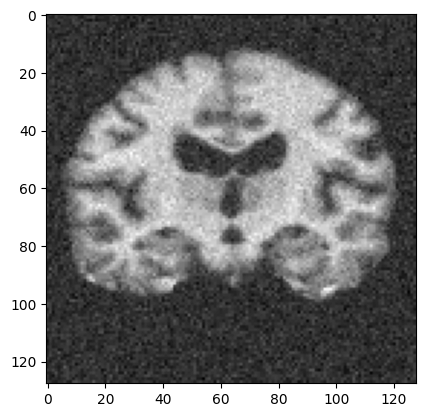

Mean Absolute Difference: 0.028956573456525803
0.04659690275794884 0.13287261638628511
tensor(0)


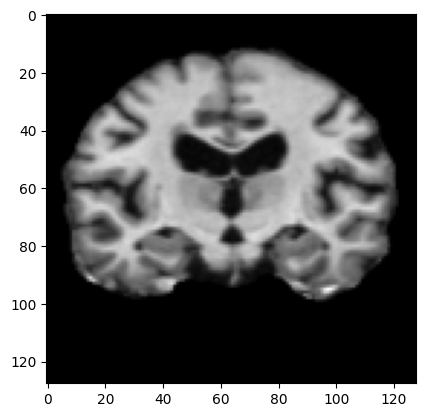

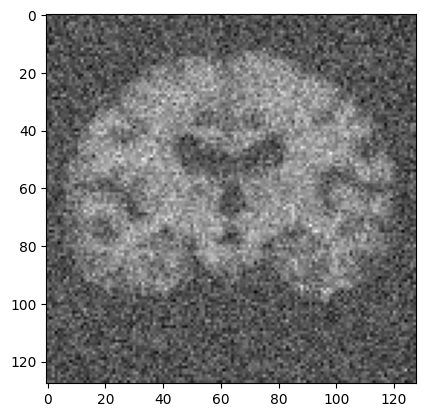

Mean Absolute Difference: 0.11236797273159027
0.04952360369849546 0.07414677007722832
tensor(0)


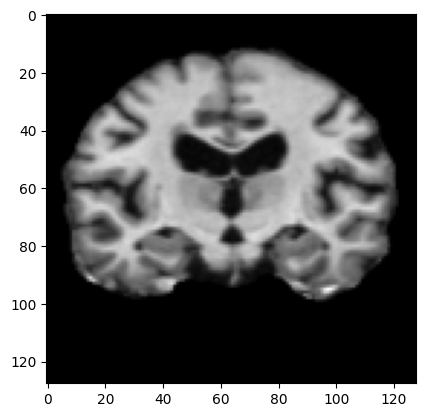

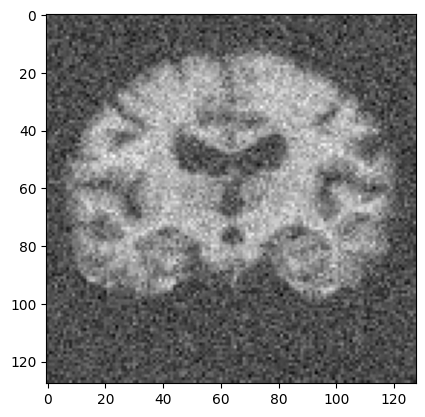

Mean Absolute Difference: 0.07246142625808716
0.03632557116974884 0.04350519136893968
tensor(0)


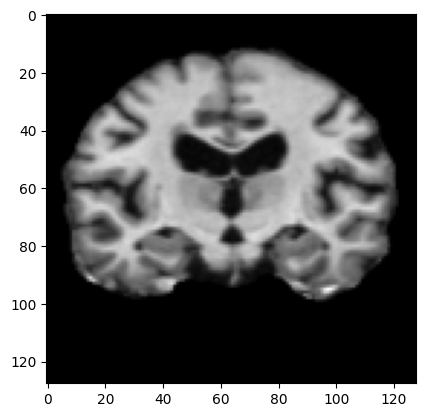

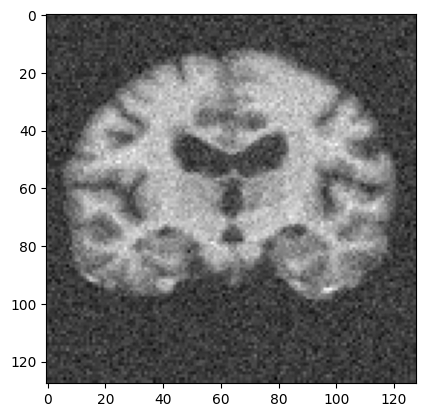

Mean Absolute Difference: 0.04586484283208847
0.010410335136041317 0.055001882002670574
tensor(0)


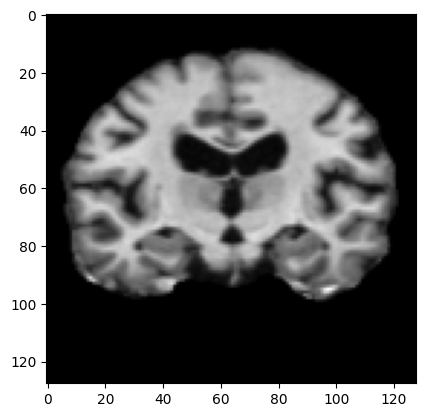

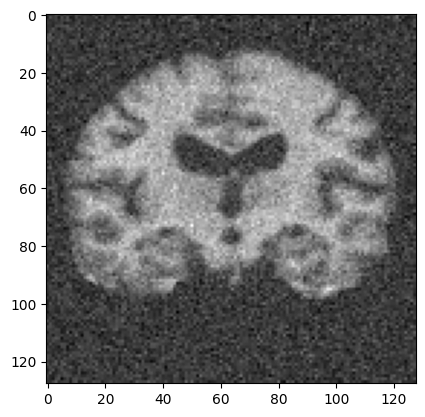

Mean Absolute Difference: 0.04479793459177017
0.02324805597768417 0.05599022917582847
tensor(0)


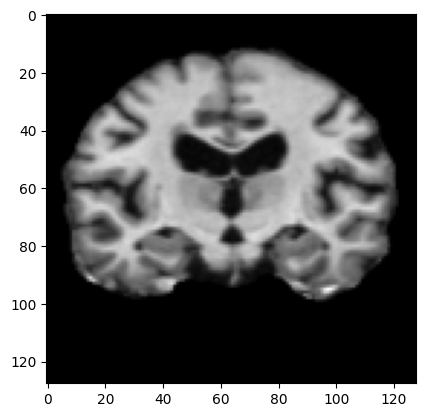

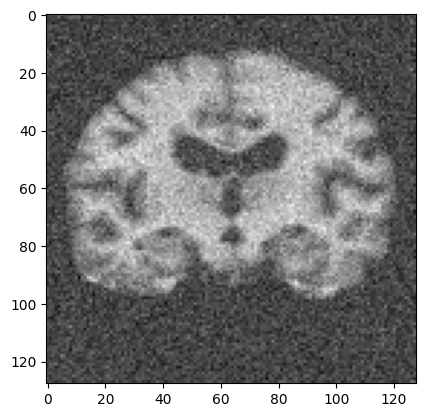

Mean Absolute Difference: 0.04853040724992752
0.01004976637993335 0.13179450575048837
tensor(0)


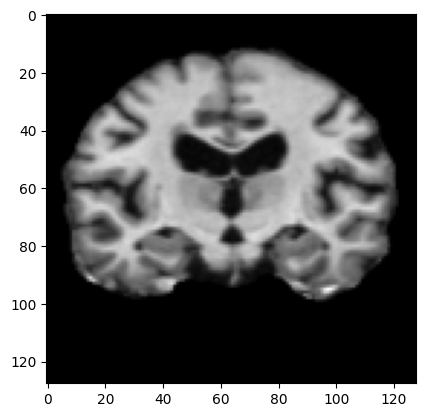

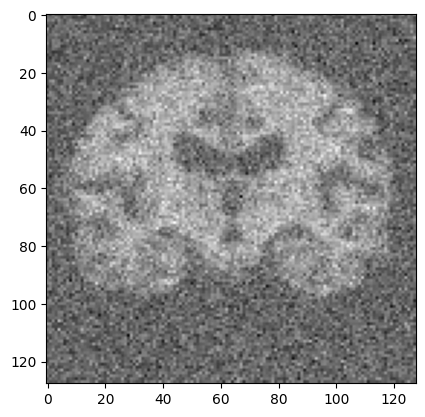

Mean Absolute Difference: 0.10503372550010681
0.014893260487972605 0.03476461804986963
tensor(0)


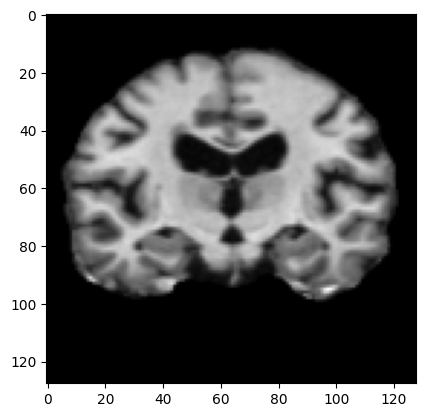

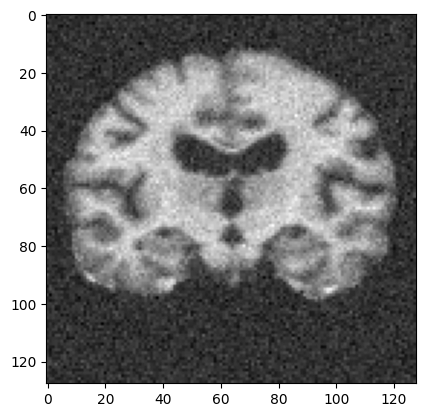

Mean Absolute Difference: 0.030488140881061554
0.03685880090928097 0.03150538765684366
tensor(0)


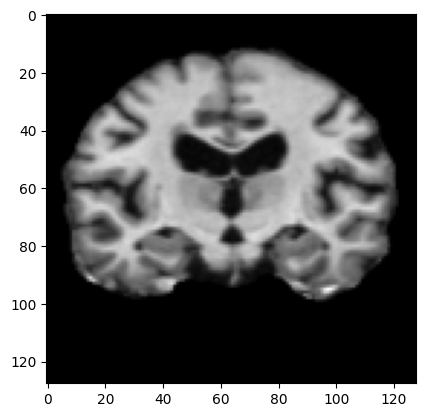

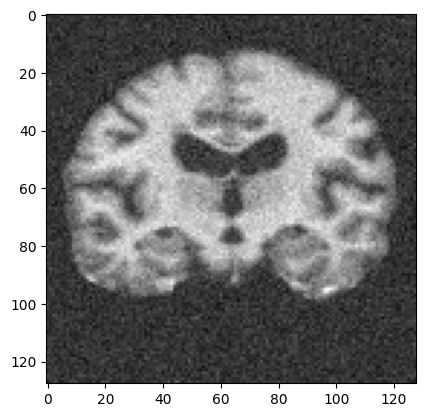

Mean Absolute Difference: 0.040902867913246155
0.034778091688625425 0.07774111264511956
tensor(0)


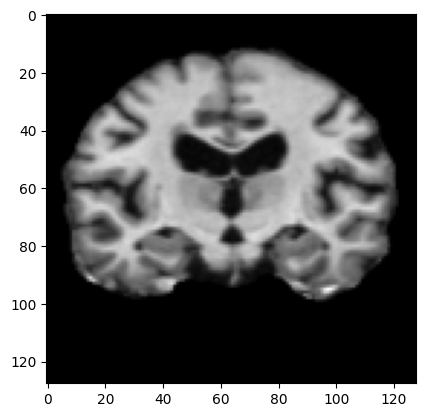

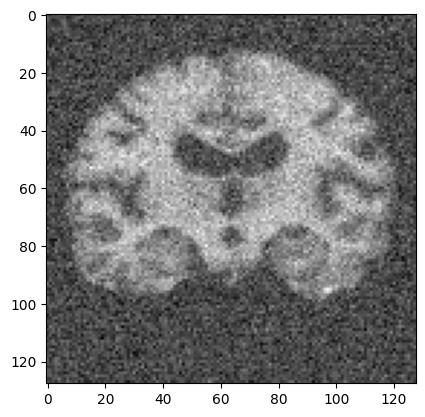

Mean Absolute Difference: 0.0681571289896965
0.018951572636512645 0.08102633724464213
tensor(0)


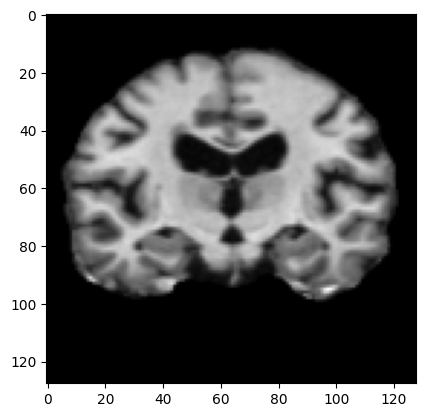

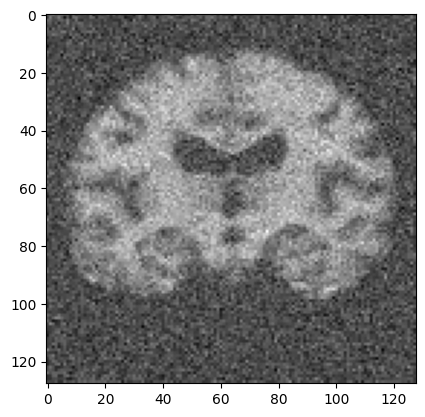

Mean Absolute Difference: 0.06682025641202927
0.04087764599302644 0.09741282066532038
tensor(0)


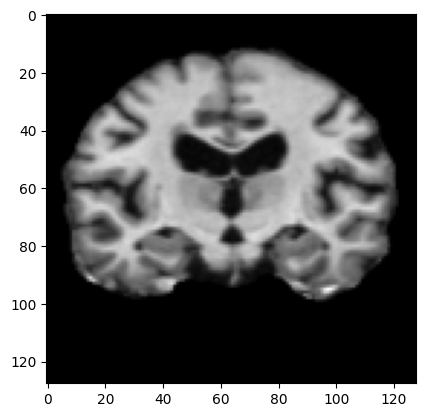

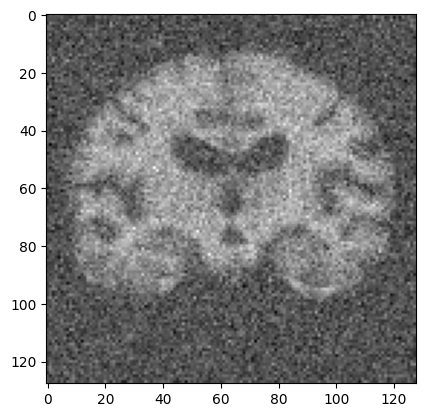

Mean Absolute Difference: 0.08560255169868469
0.046018403732920654 0.13153230106877867
tensor(0)


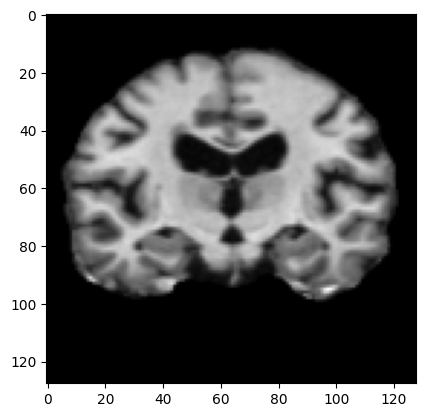

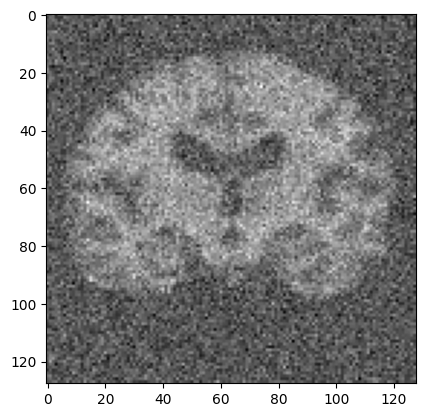

Mean Absolute Difference: 0.11122915893793106
0.0383941296146213 0.016420522746573993
tensor(0)


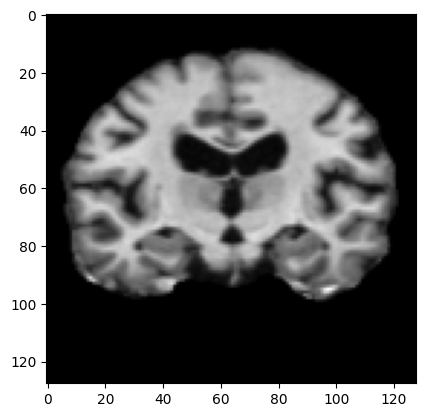

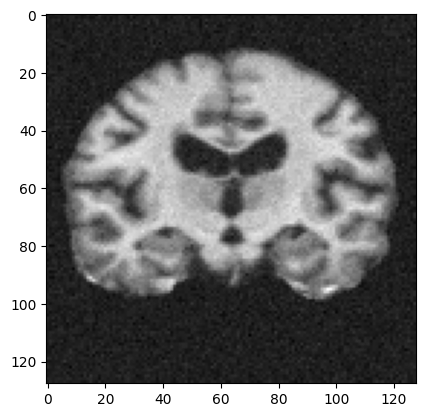

Mean Absolute Difference: 0.03833567351102829
0.026633023699972298 0.15952994123156866
tensor(0)


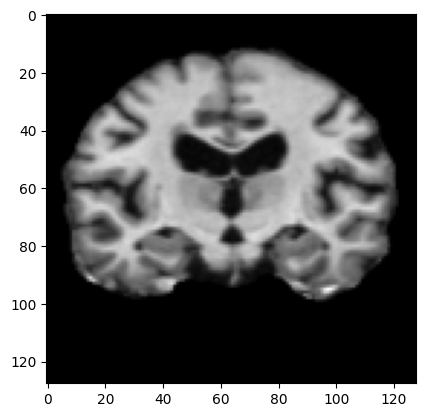

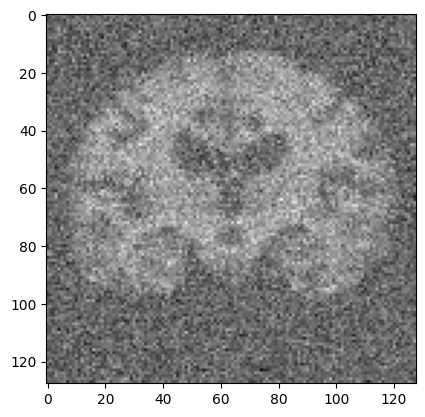

Mean Absolute Difference: 0.12916049361228943
0.015741776936719045 0.08463652498698382
tensor(0)


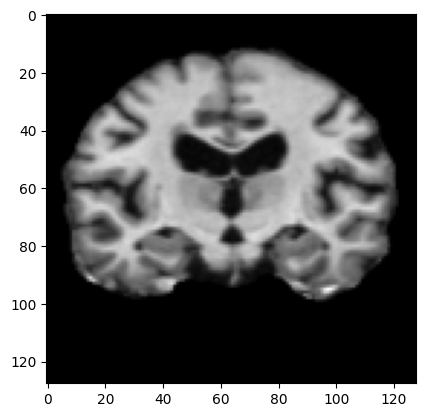

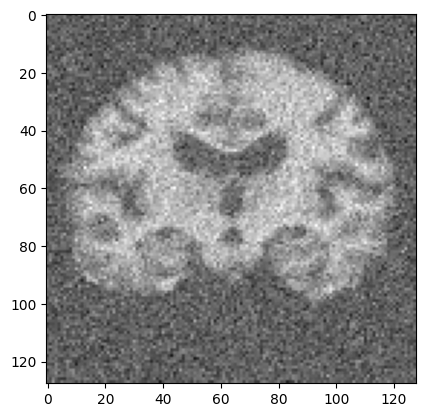

Mean Absolute Difference: 0.06811802834272385
0.031109516956447005 0.21224313280751297
tensor(0)


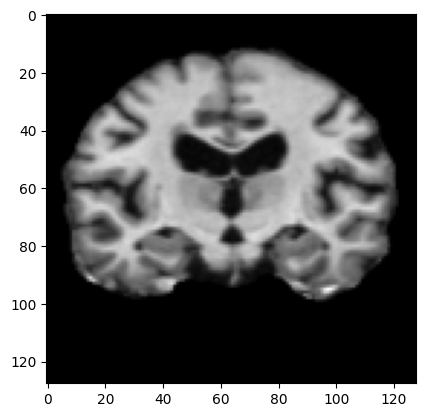

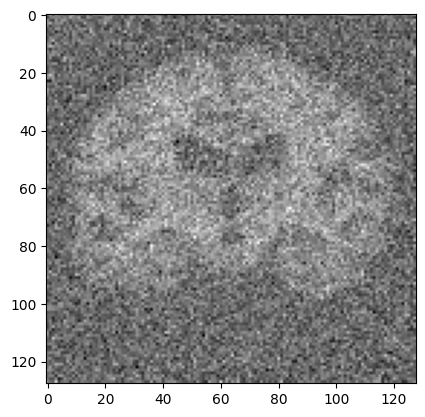

Mean Absolute Difference: 0.16973313689231873
0.008323776981528547 0.013632531302637023
tensor(0)


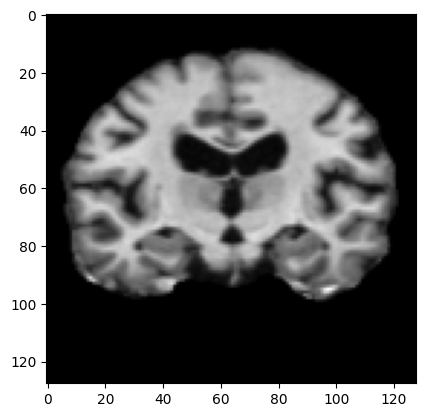

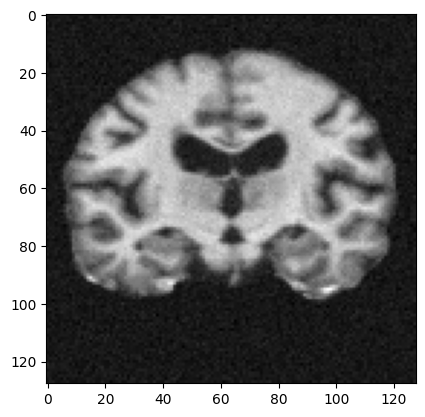

Mean Absolute Difference: 0.01284793671220541
0.025467222824293662 0.20631736791207542
tensor(0)


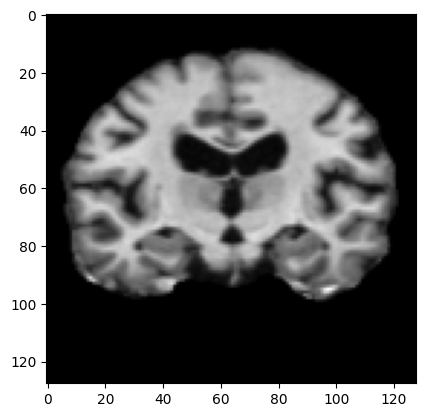

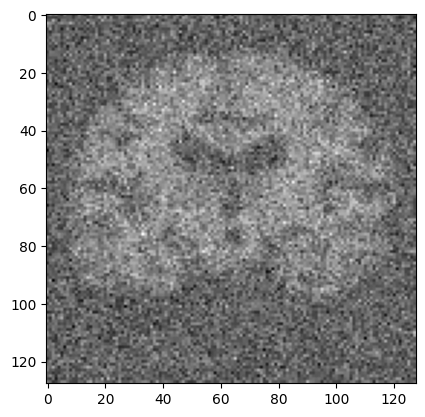

Mean Absolute Difference: 0.1661096215248108
0.022133602872324232 0.107109968256431
tensor(0)


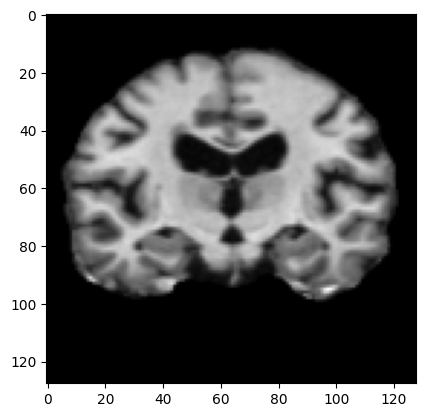

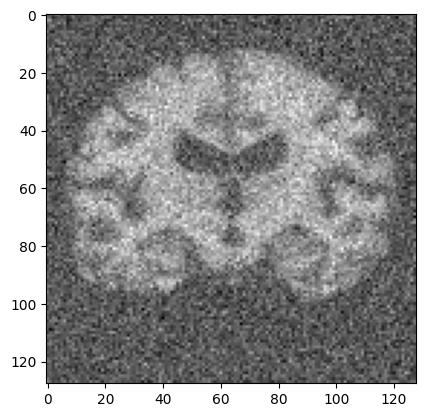

Mean Absolute Difference: 0.08646252751350403
0.011029807932047398 0.1326552455083796
tensor(0)


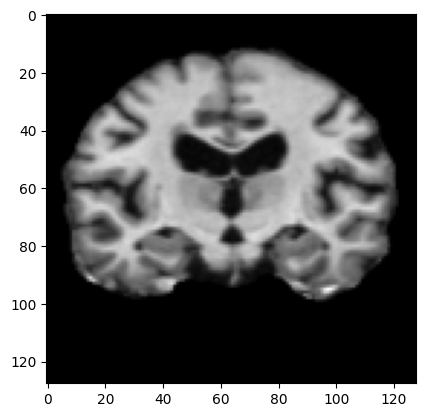

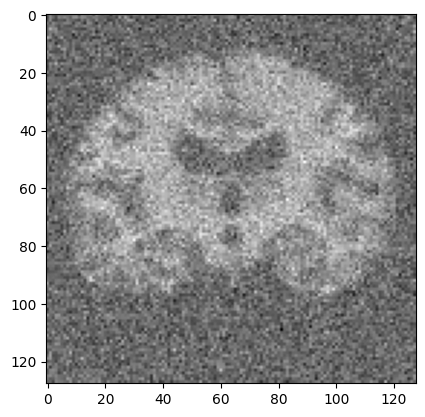

Mean Absolute Difference: 0.10681378096342087
0.04296731475940738 0.20329011451710985
tensor(0)


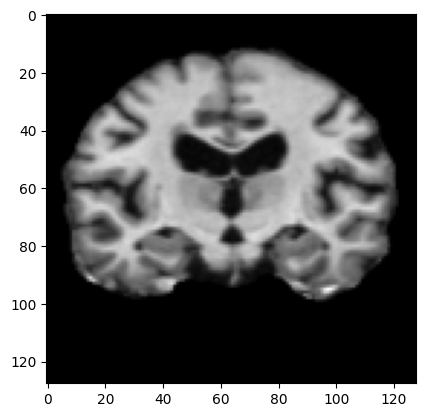

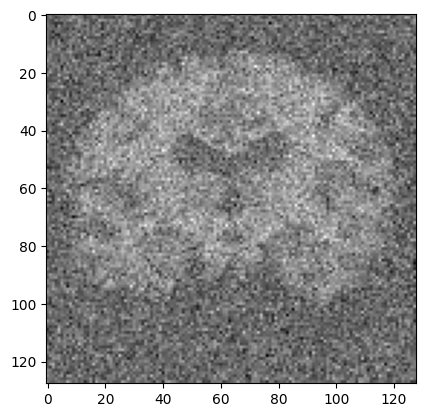

Mean Absolute Difference: 0.16401390731334686
0.020585732501050908 0.05156816031226311
tensor(0)


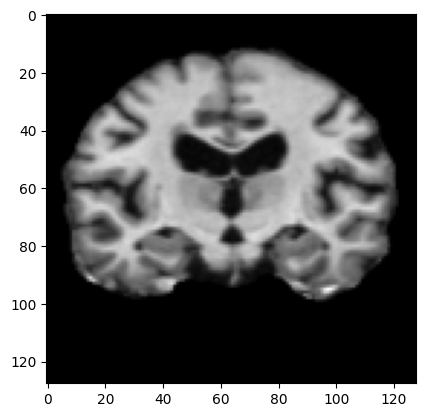

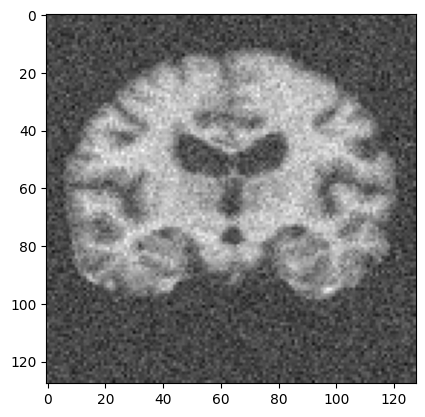

Mean Absolute Difference: 0.04448717087507248
0.042429319503600536 0.1664211710326296
tensor(0)


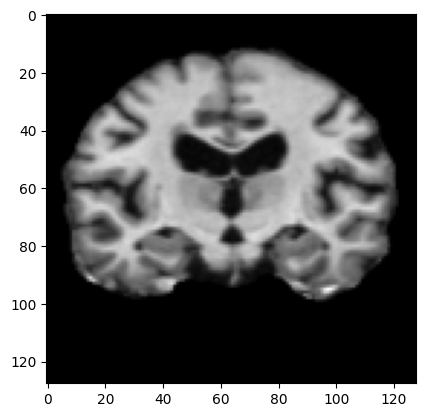

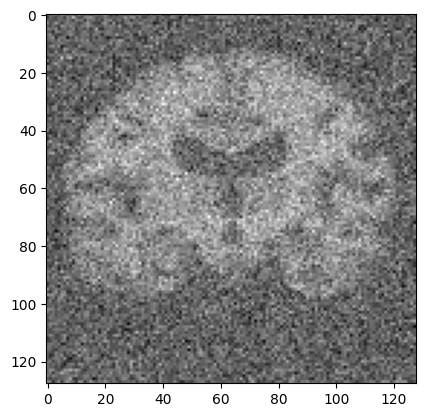

Mean Absolute Difference: 0.1374993771314621
0.04279699790163197 0.20235050304828342
tensor(0)


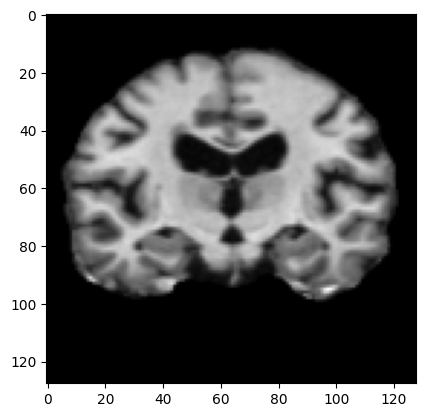

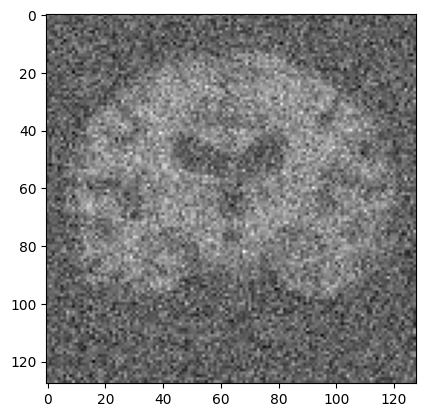

Mean Absolute Difference: 0.16365854442119598
0.012448869532629699 0.0565835042947904
tensor(0)


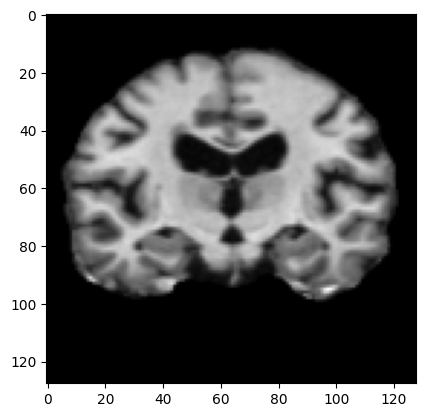

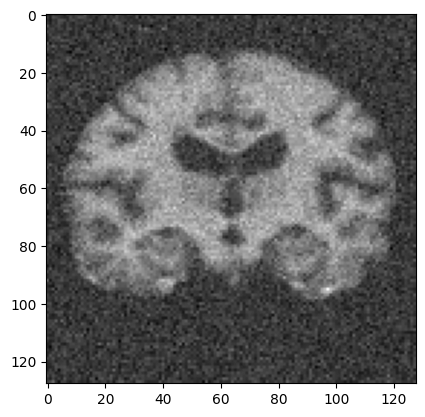

Mean Absolute Difference: 0.046359725296497345
0.04949988206317053 0.009363472477172358
tensor(0)


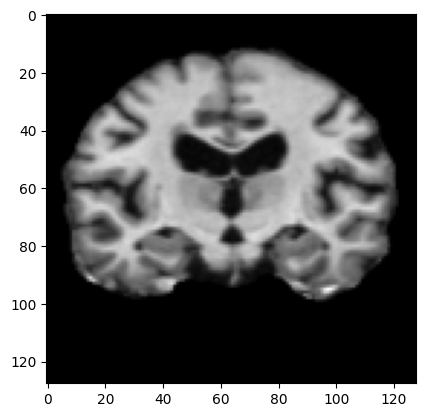

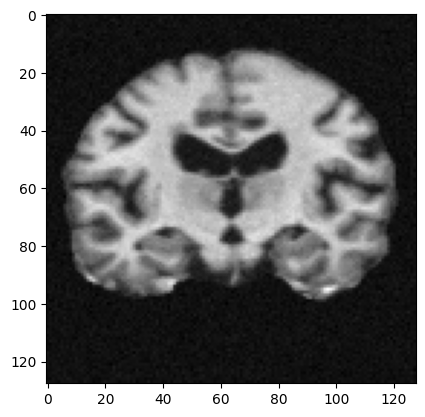

Mean Absolute Difference: 0.049409326165914536
0.0062185111590744085 0.17661674456542625
tensor(0)


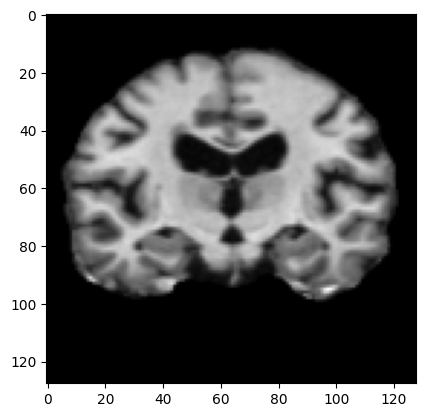

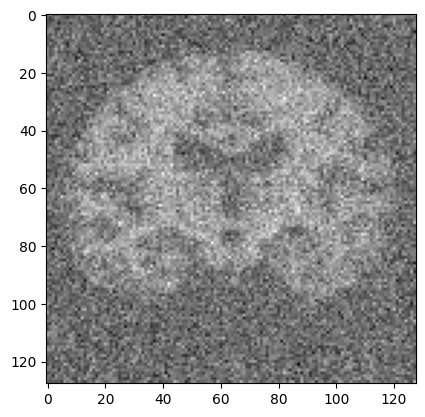

Mean Absolute Difference: 0.1415531039237976
0.04352780482676594 0.21163861979164783
tensor(0)


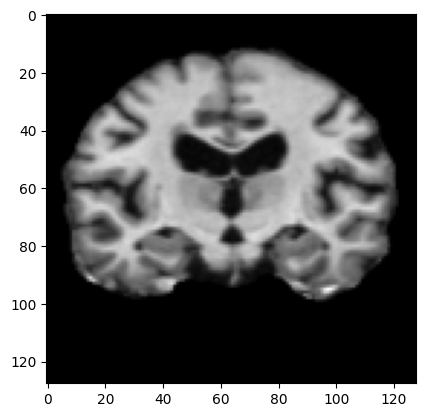

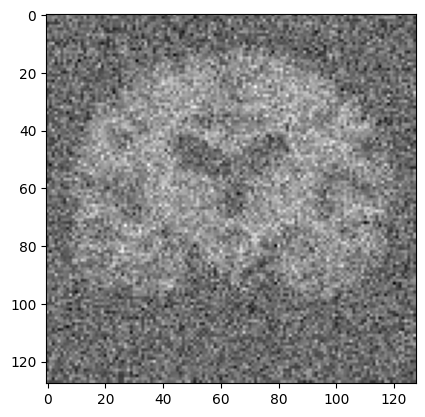

Mean Absolute Difference: 0.1714322715997696
0.03550152445044985 0.08000344143975037
tensor(0)


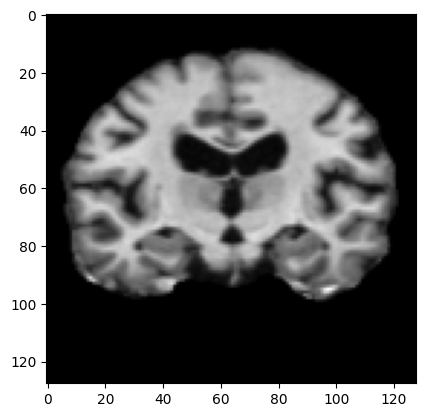

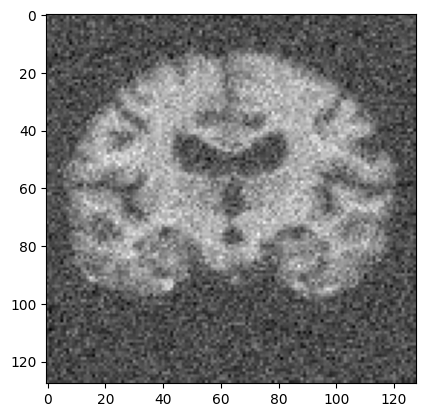

Mean Absolute Difference: 0.07018262892961502
0.021106308579025235 0.047120288490854666
tensor(0)


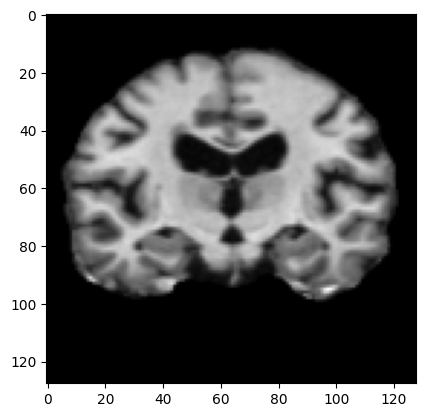

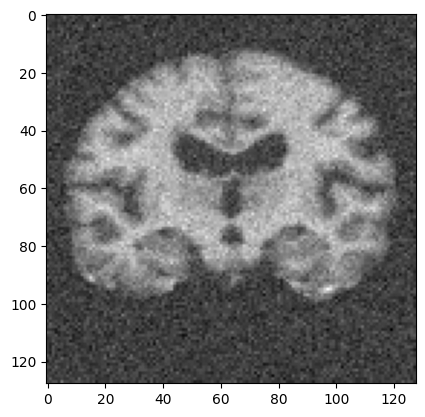

Mean Absolute Difference: 0.041605208069086075
0.03129336360509492 0.067466506319198
tensor(0)


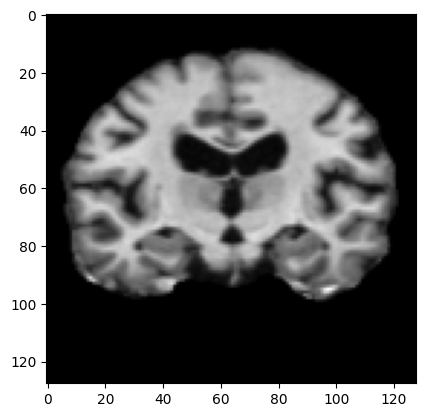

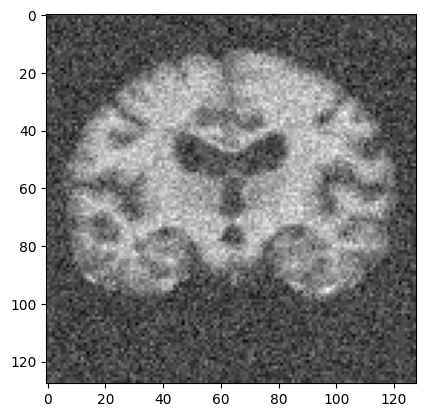

Mean Absolute Difference: 0.05895594134926796
0.02723620580241693 0.21100915717725202
tensor(0)


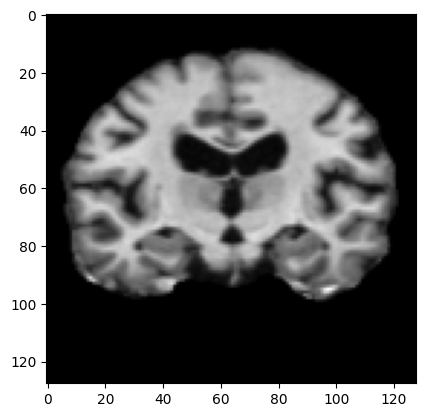

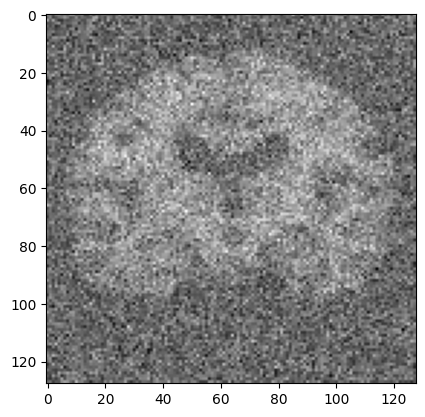

Mean Absolute Difference: 0.16829487681388855
0.014170460386964984 0.08191438008107603
tensor(0)


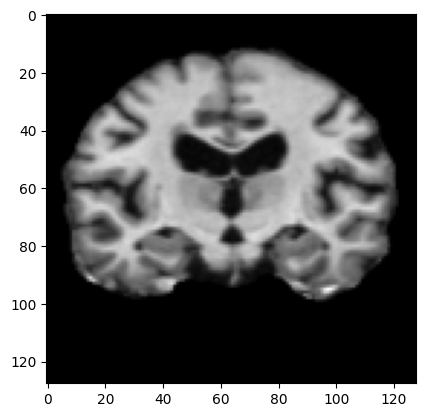

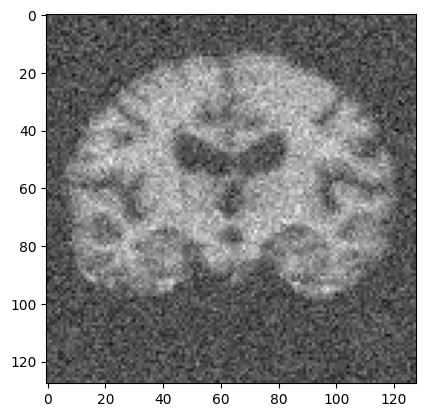

Mean Absolute Difference: 0.06648410856723785
0.007722285913175276 0.013280366952857336
tensor(0)


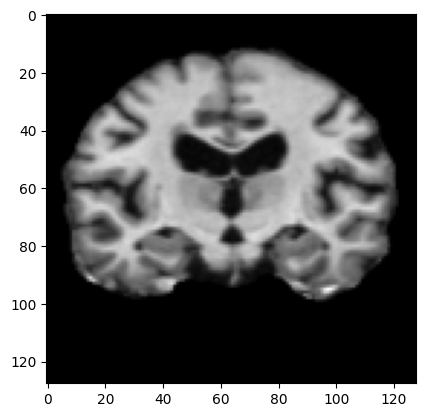

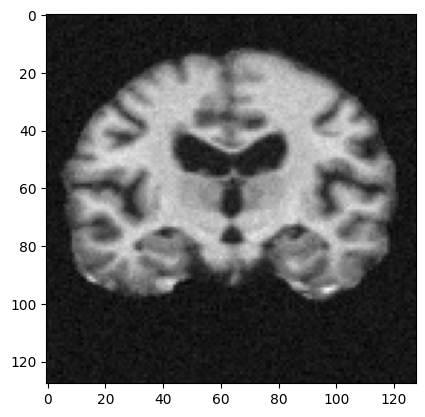

Mean Absolute Difference: 0.01225597970187664
0.03574011198424537 0.09663239748192973
tensor(0)


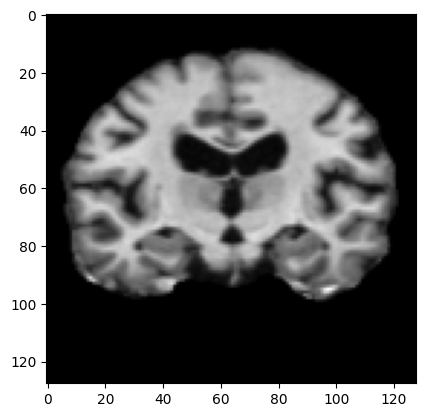

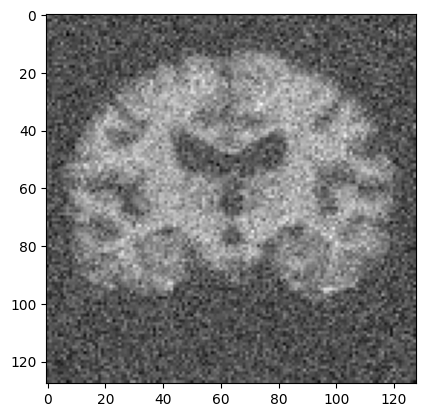

Mean Absolute Difference: 0.08166100084781647
0.023750268104351508 0.19084744899000375
tensor(0)


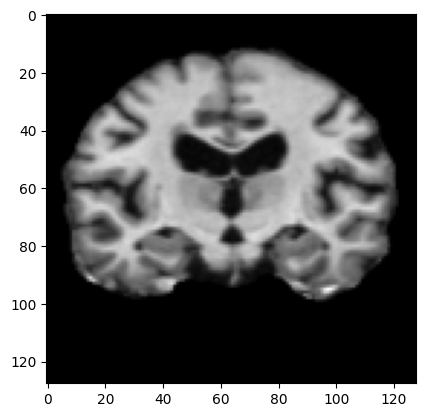

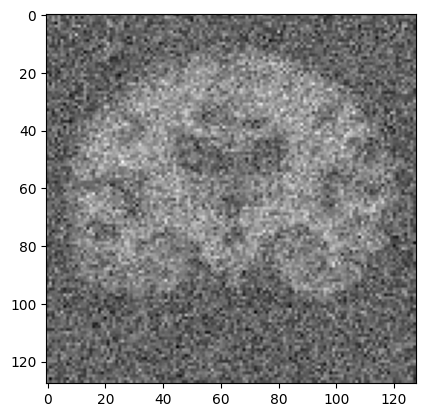

Mean Absolute Difference: 0.15414024889469147
0.013043363395121988 0.08430032895393161
tensor(0)


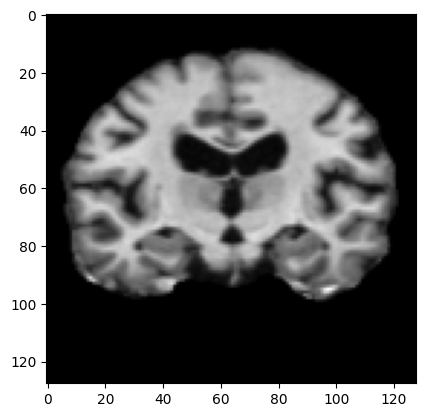

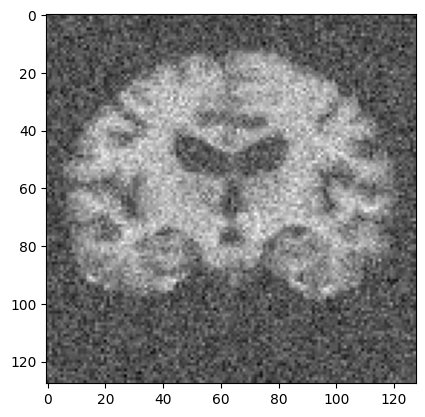

Mean Absolute Difference: 0.06843945384025574
0.0037116735891925046 0.2153379442395293
tensor(0)


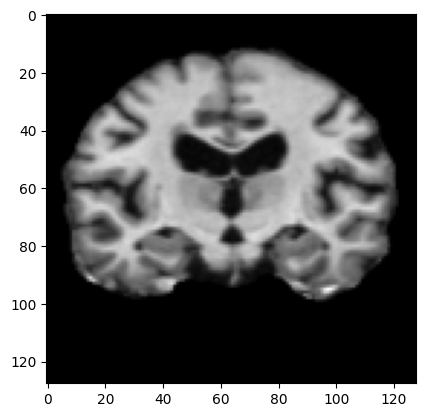

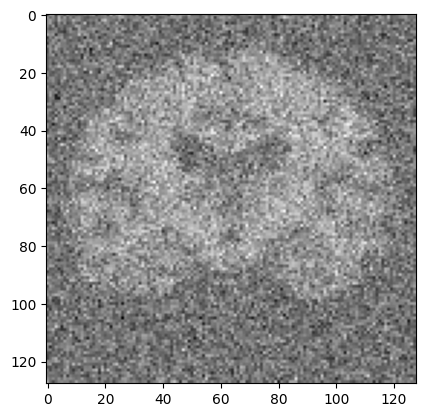

Mean Absolute Difference: 0.1726146638393402
0.01988659507251162 0.18689824686249862
tensor(0)


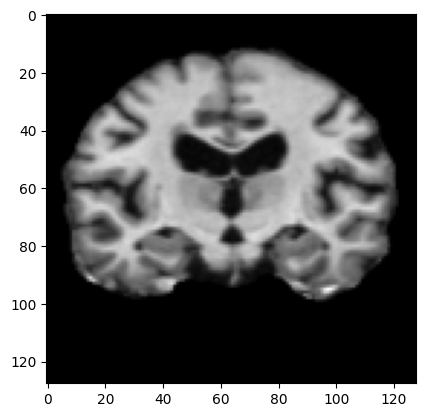

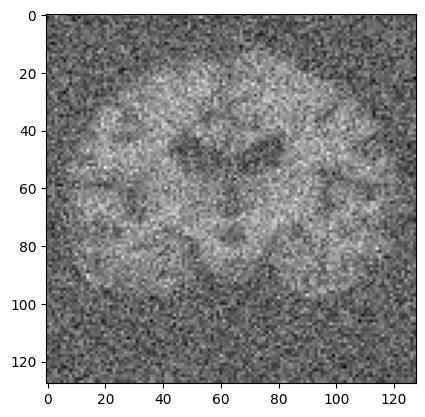

Mean Absolute Difference: 0.14973580837249756
0.02223010400912061 0.10911250110189488
tensor(0)


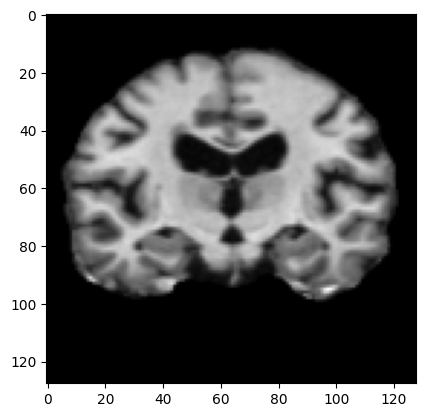

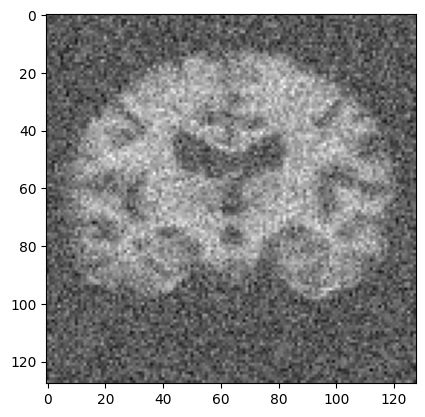

Mean Absolute Difference: 0.08905867487192154
0.02339985662563242 0.11012156605574709
tensor(0)


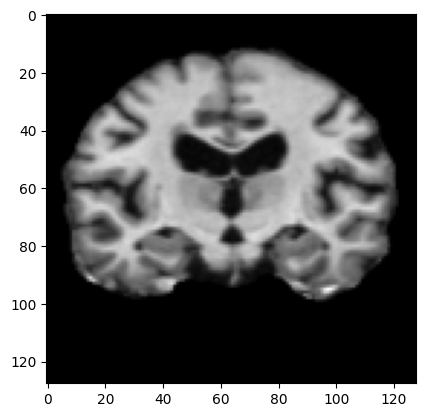

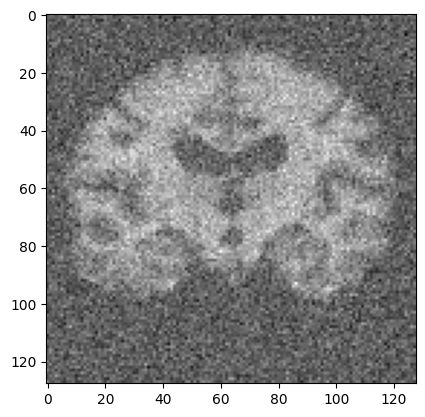

Mean Absolute Difference: 0.090659961104393
0.005792186458793353 0.20906678949904672
tensor(0)


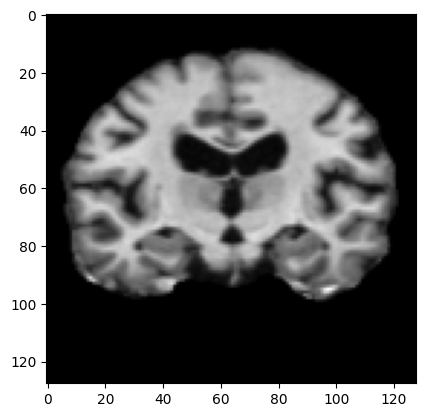

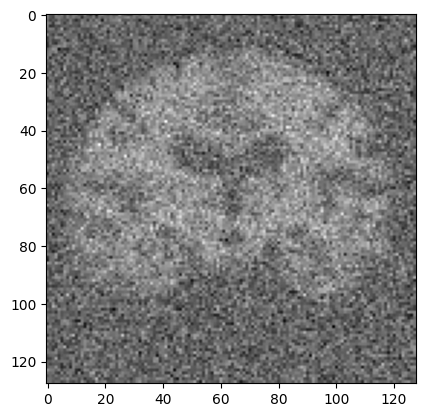

Mean Absolute Difference: 0.16651077568531036
0.029513739138033436 0.10357472929779915
tensor(0)


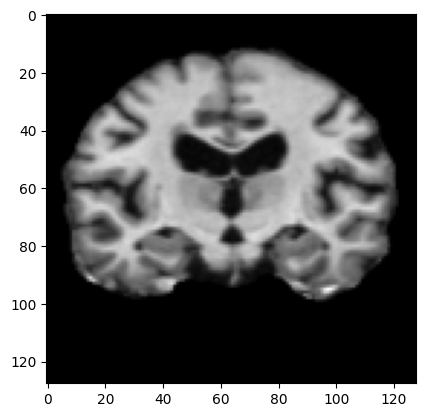

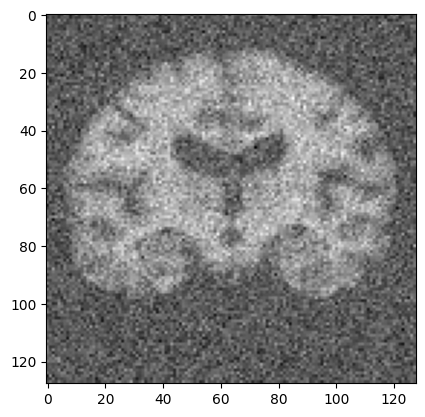

Mean Absolute Difference: 0.08621915429830551
0.04490223713765888 0.11683745650403209
tensor(0)


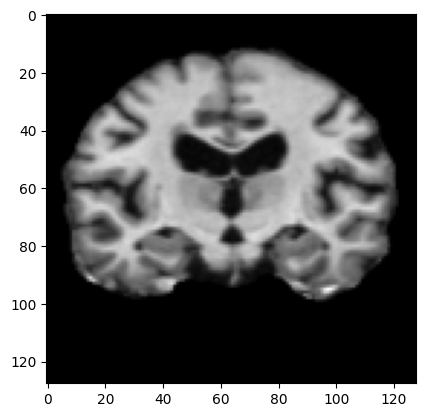

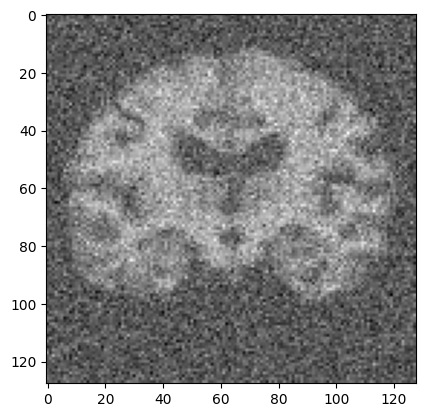

Mean Absolute Difference: 0.099423848092556
0.04933262415507399 0.07712067578897627
tensor(0)


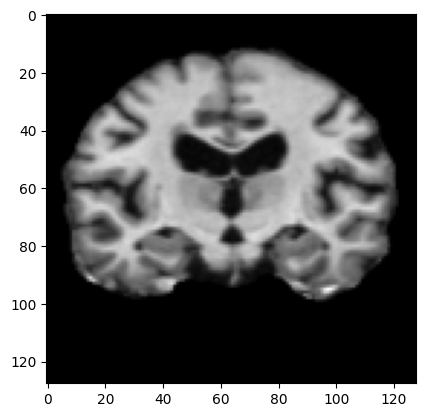

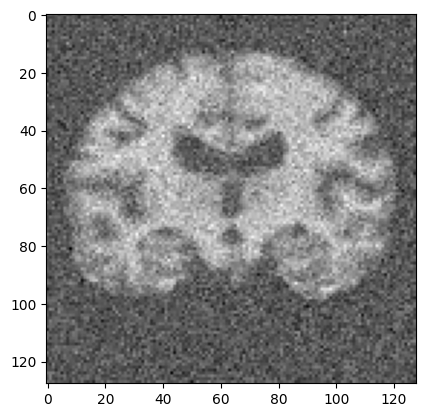

Mean Absolute Difference: 0.07374157011508942
0.028234566479710007 0.012632754586052161
tensor(0)


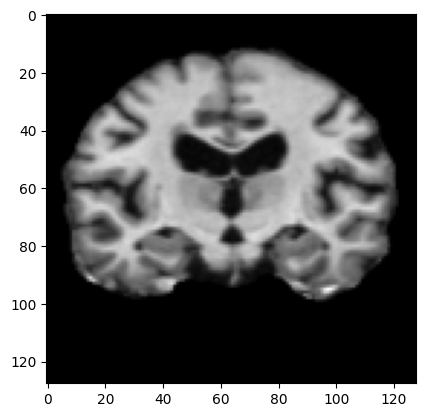

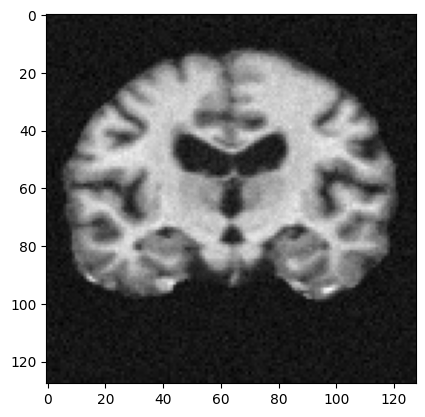

Mean Absolute Difference: 0.028422508388757706
0.020091514097748793 0.018580638495703898
tensor(0)


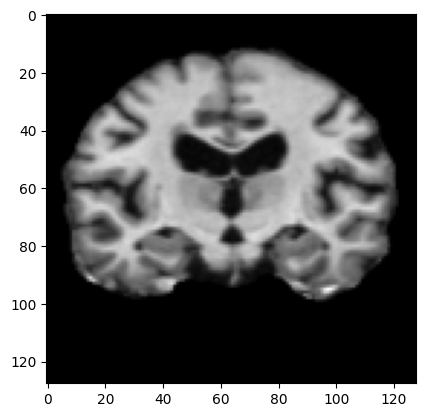

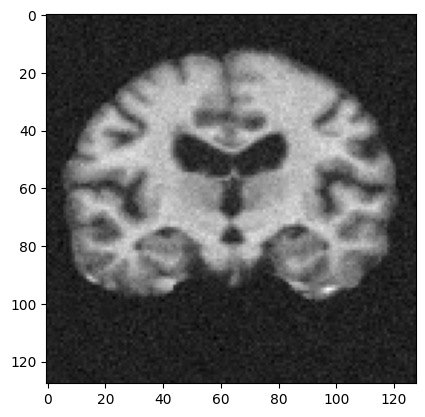

Mean Absolute Difference: 0.022887136787176132
0.032047640022909454 0.20069327179303512
tensor(0)


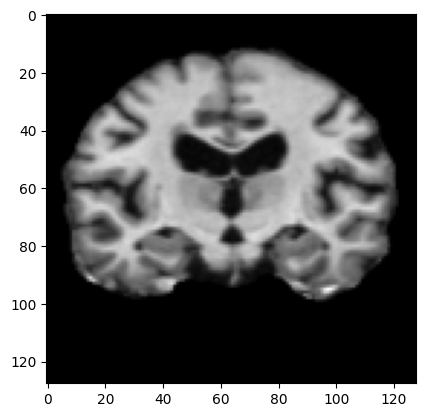

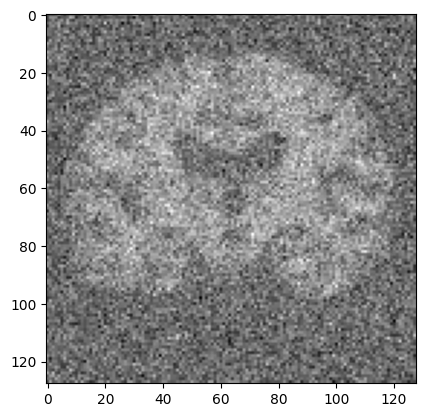

Mean Absolute Difference: 0.16120195388793945
0.04512046909941556 0.07512373954391256
tensor(0)


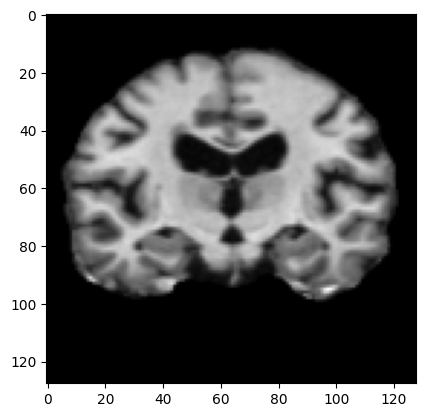

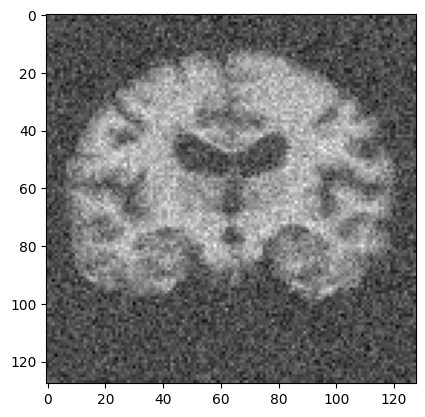

Mean Absolute Difference: 0.07092298567295074
0.002378695644614326 0.20760633912487617
tensor(0)


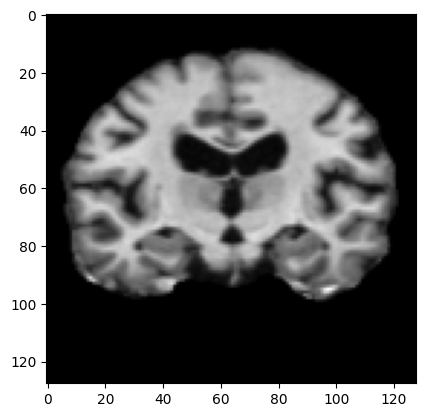

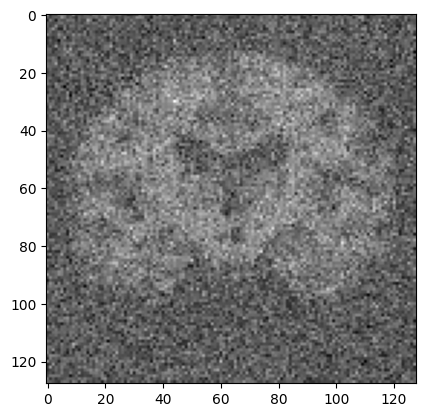

Mean Absolute Difference: 0.1666841208934784
0.0004868091518520135 0.028770146850847944
tensor(0)


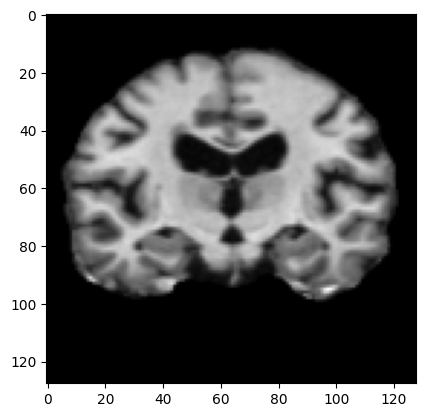

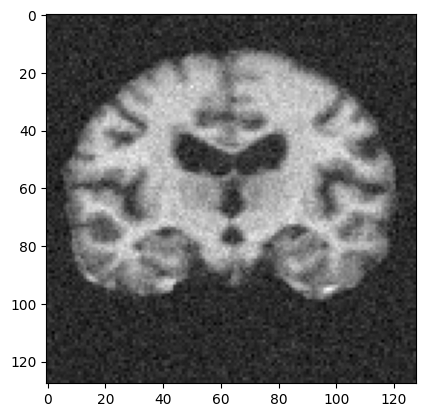

Mean Absolute Difference: 0.02304711751639843
0.04581999811465658 0.11133989961705967
tensor(0)


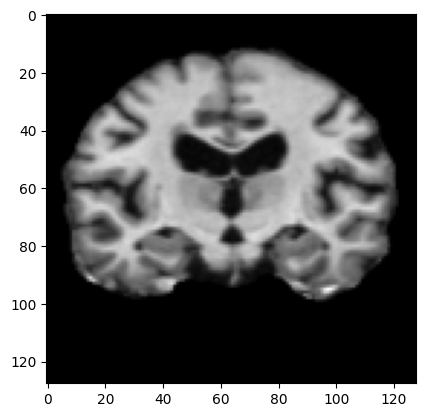

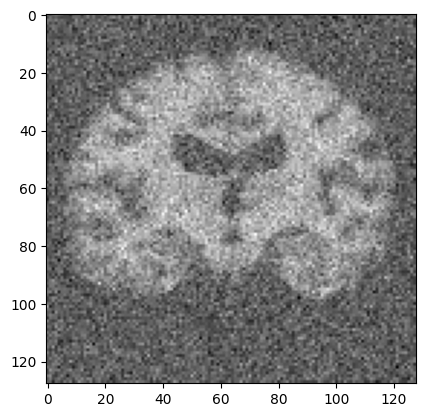

Mean Absolute Difference: 0.096648670732975
0.01196633702619141 0.1931666081973374
tensor(0)


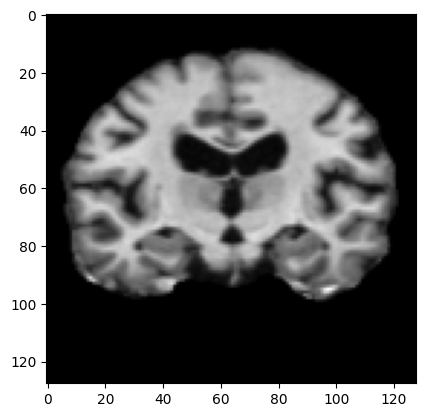

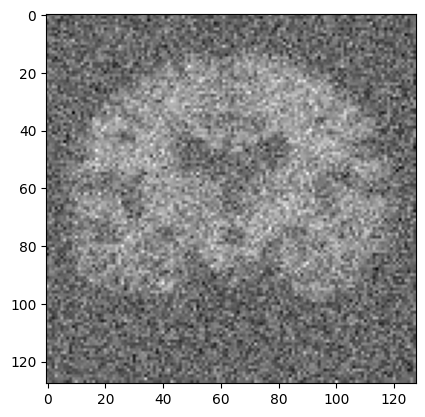

Mean Absolute Difference: 0.15549533069133759
0.04392347598466889 0.12933082128497195
tensor(0)


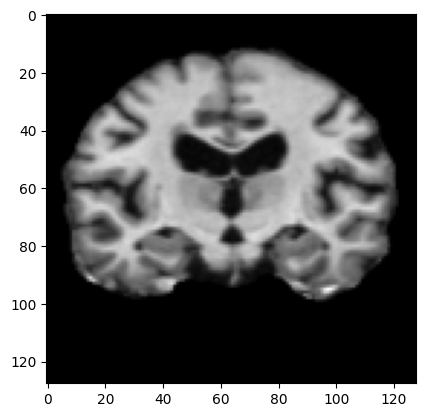

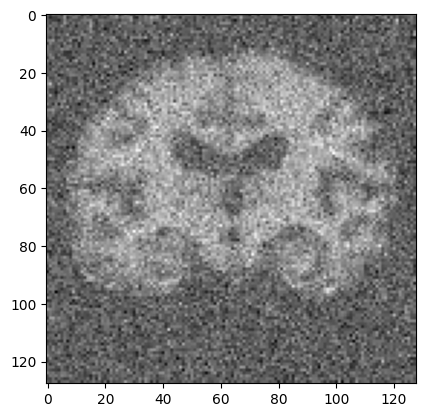

Mean Absolute Difference: 0.10905510187149048
0.0211772801413309 0.06188063097813579
tensor(0)


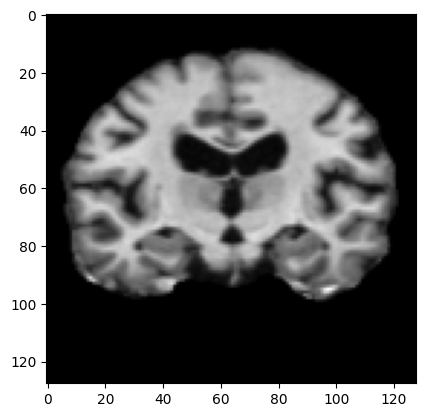

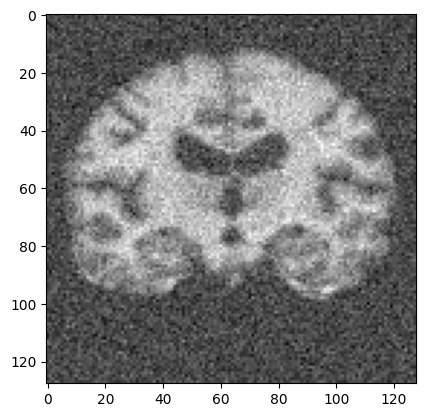

Mean Absolute Difference: 0.05331989377737045
0.024744755791924464 0.005495245656915971
tensor(0)


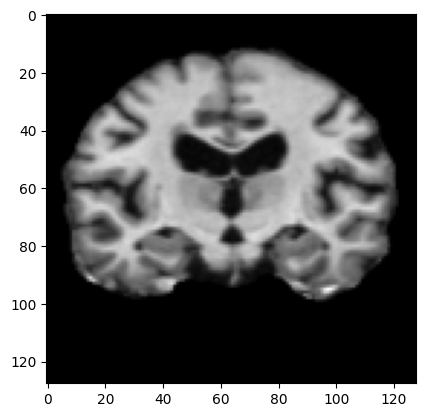

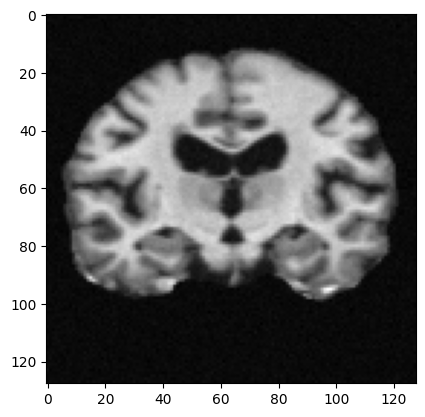

Mean Absolute Difference: 0.024718234315514565
0.03654173517486475 0.0564893957993256
tensor(0)


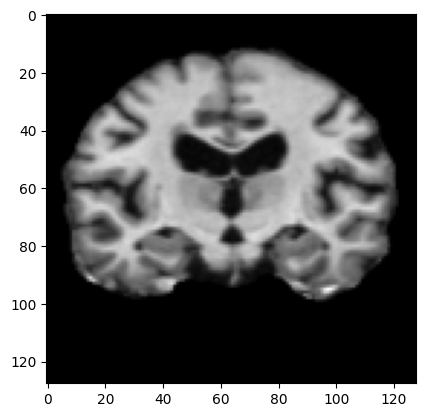

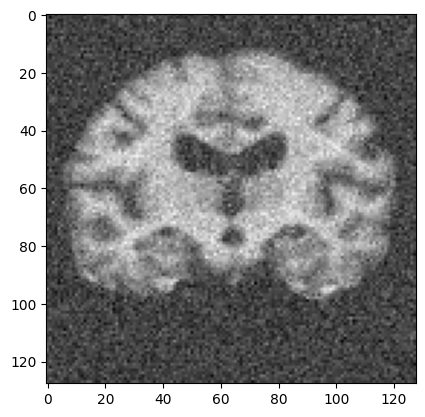

Mean Absolute Difference: 0.05412326380610466
168 ms ± 1.89 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [9]:
%%timeit

img, seg = load_sample()

mean = random.uniform(0, 0.005)
std = random.uniform(0, 0.05)  # std_square = [0, 0.05]

mean = random.uniform(0, 0.05)
std = random.uniform(0, 0.22)  # std_square = [0, 0.05]

# noise = std * torch.randn_like(img) + mean
img2 = img + std * torch.randn_like(img) + mean

print(mean, std)
print(torch.sum(img2==img))
show_image(img, "gray")
show_image(img2, "gray")

# Assuming img and img2 are your images
mad = torch.mean(torch.abs(img2 - img))
print("Mean Absolute Difference:", mad.item())